In [55]:
import time

import matplotlib.pyplot as plt
from matplotlib import rcParams
import matplotlib
from IPython.display import Image, display, clear_output
from PIL import Image

import numpy as np
import pandas as pd
import scipy as sp
import scipy.stats as stats

import tarfile
import csv

import tensorflow as tf
from tensorflow.keras.layers import Dense, Flatten, Conv2D
from tensorflow.keras import models, layers
plt.rcParams.update({
    "text.usetex": False,
    "font.family": "sans-serif",
    "font.sans-serif": ["Helvetica"]})

In [56]:
#heatmap function to generate a visualization of our correlation matrix

def heatmap(data, row_labels, col_labels, ax=None,
            cbar_kw={}, cbarlabel="", **kwargs):
    """
    Create a heatmap from a numpy array and two lists of labels.

    Parameters
    ----------
    data
        A 2D numpy array of shape (N, M).
    row_labels
        A list or array of length N with the labels for the rows.
    col_labels
        A list or array of length M with the labels for the columns.
    ax
        A `matplotlib.axes.Axes` instance to which the heatmap is plotted.  If
        not provided, use current axes or create a new one.  Optional.
    cbar_kw
        A dictionary with arguments to `matplotlib.Figure.colorbar`.  Optional.
    cbarlabel
        The label for the colorbar.  Optional.
    **kwargs
        All other arguments are forwarded to `imshow`.
    """

    if not ax:
        ax = plt.gca()

    # Plot the heatmap
    im = ax.imshow(data, **kwargs)

    # Create colorbar
    cbar = ax.figure.colorbar(im, ax=ax, **cbar_kw)
    cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")

    # We want to show all ticks...
    ax.set_xticks(np.arange(data.shape[1]))
    ax.set_yticks(np.arange(data.shape[0]))
    # ... and label them with the respective list entries.
    ax.set_xticklabels(col_labels)
    ax.set_yticklabels(row_labels)

    # Let the horizontal axes labeling appear on top.
    ax.tick_params(top=True, bottom=False,
                   labeltop=True, labelbottom=False)

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=-30, ha="right",
             rotation_mode="anchor")

    # Turn spines off and create white grid.
    ax.spines['left'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)

    ax.set_xticks(np.arange(data.shape[1]+1)-.5, minor=True)
    ax.set_yticks(np.arange(data.shape[0]+1)-.5, minor=True)
    ax.grid(which="minor", color="w", linestyle='-', linewidth=3)
    ax.tick_params(which="minor", bottom=False, left=False)

    return im, cbar


#function which annotates the heatmap so that we can view
#the quantitative nature of the data as well as the visualization of that quantification

def annotate_heatmap(im, data=None, valfmt="{x:.2f}",
                     textcolors=("black", "white"),
                     threshold=None, **textkw):
    """
    A function to annotate a heatmap.

    Parameters
    ----------
    im
        The AxesImage to be labeled.
    data
        Data used to annotate.  If None, the image's data is used.  Optional.
    valfmt
        The format of the annotations inside the heatmap.  This should either
        use the string format method, e.g. "$ {x:.2f}", or be a
        `matplotlib.ticker.Formatter`.  Optional.
    textcolors
        A pair of colors.  The first is used for values below a threshold,
        the second for those above.  Optional.
    threshold
        Value in data units according to which the colors from textcolors are
        applied.  If None (the default) uses the middle of the colormap as
        separation.  Optional.
    **kwargs
        All other arguments are forwarded to each call to `text` used to create
        the text labels.
    """

    if not isinstance(data, (list, np.ndarray)):
        data = im.get_array()

    # Normalize the threshold to the images color range.
    if threshold is not None:
        threshold = im.norm(threshold)
    else:
        threshold = im.norm(data.max())/2.

    # Set default alignment to center, but allow it to be
    # overwritten by textkw.
    kw = dict(horizontalalignment="center",
              verticalalignment="center")
    kw.update(textkw)

    # Get the formatter in case a string is supplied
    if isinstance(valfmt, str):
        valfmt = matplotlib.ticker.StrMethodFormatter(valfmt)

    # Loop over the data and create a `Text` for each "pixel".
    # Change the text's color depending on the data.
    texts = []
    for i in range(data.shape[0]):
        for j in range(data.shape[1]):
            kw.update(color=textcolors[int(im.norm(data[i, j]) > threshold)])
            text = im.axes.text(j, i, valfmt(data[i, j], None), **kw)
            texts.append(text)

    return texts

In [103]:
#cell that extracts data from the tarfile for further manipulation and usage

get_data_bool=True

if get_data_bool:
    training_images = tarfile.open("training_images.tar", "r:tar")
    training_images.extractall()
    train_img_list = training_images.getmembers()
    training_images.close()

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBC204273D0>
(424, 424, 3)


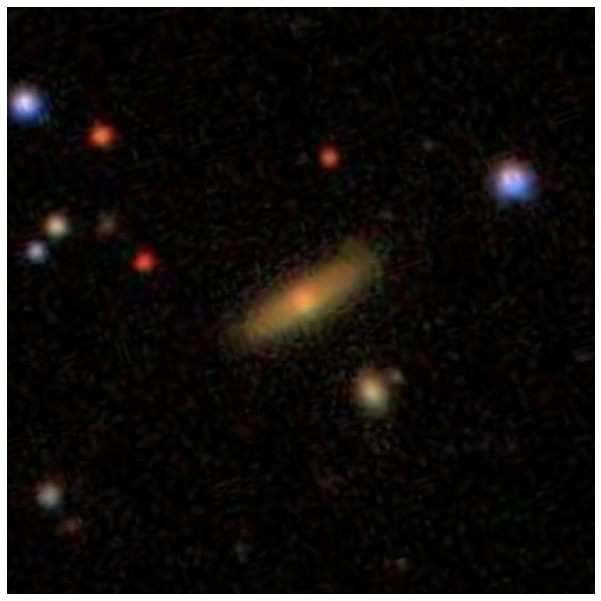

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBDB54F91D0>
(424, 424, 3)


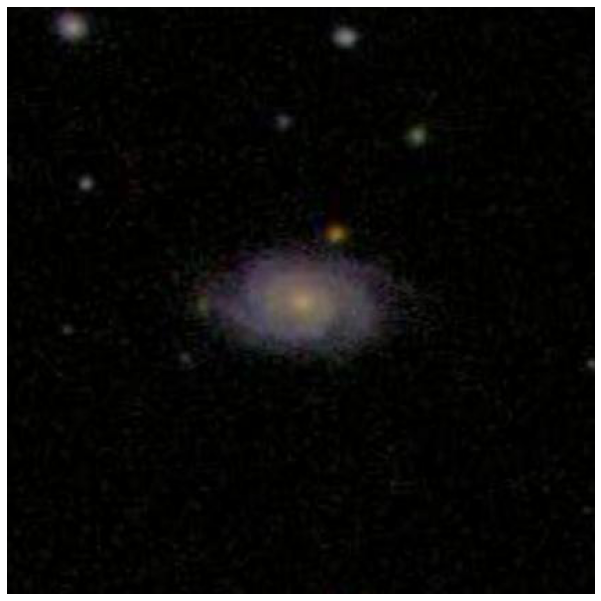

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBF72E5BE90>
(424, 424, 3)


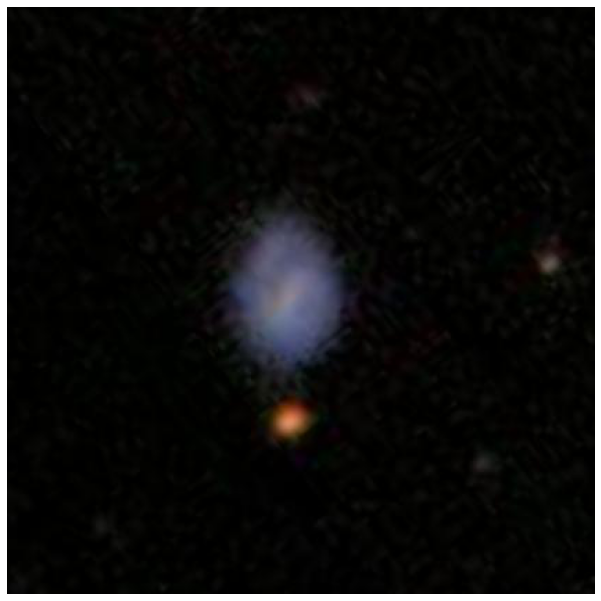

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBF72E6DB10>
(424, 424, 3)


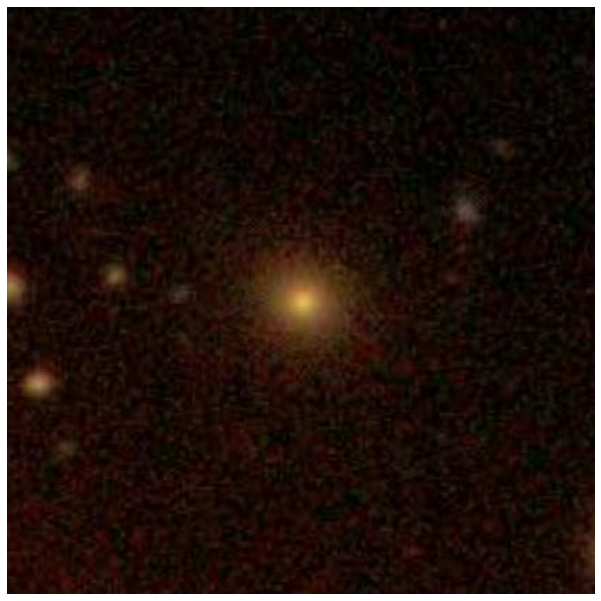

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBDB52AFAD0>
(424, 424, 3)


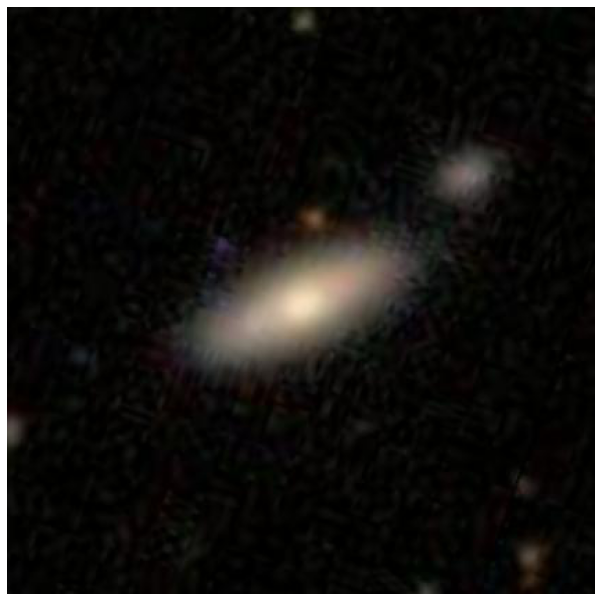

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBDB3F704D0>
(424, 424, 3)


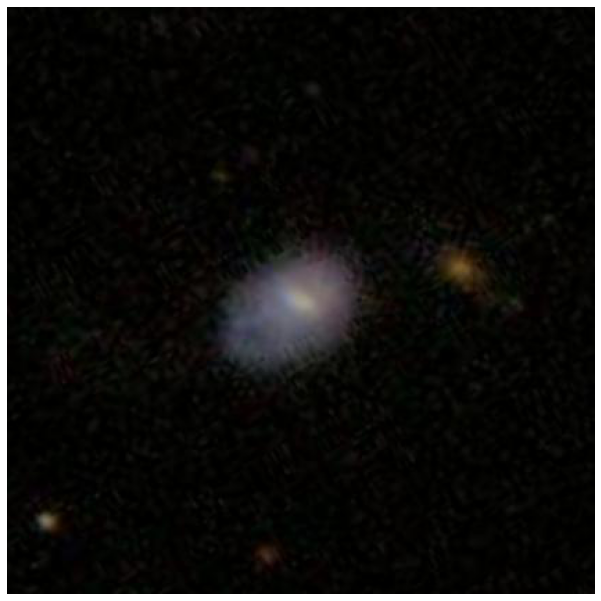

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBF740D1250>
(424, 424, 3)


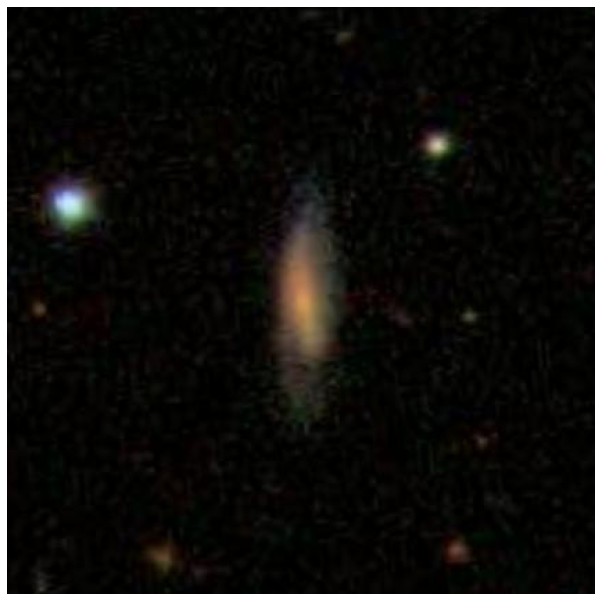

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBFDF104210>
(424, 424, 3)


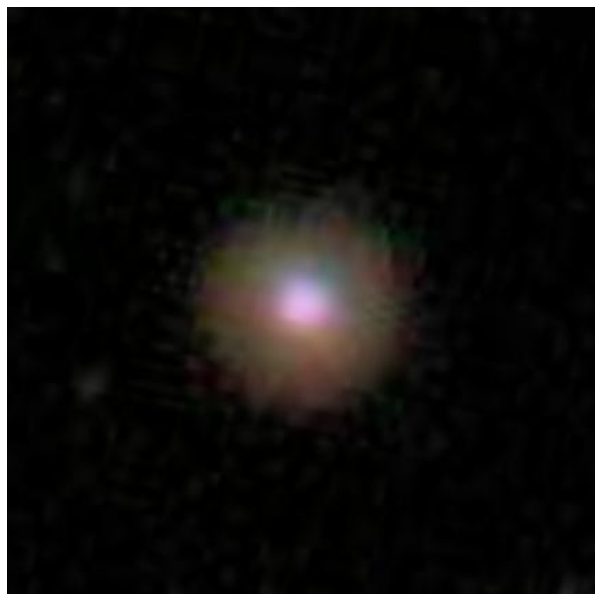

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBFDEF39B90>
(424, 424, 3)


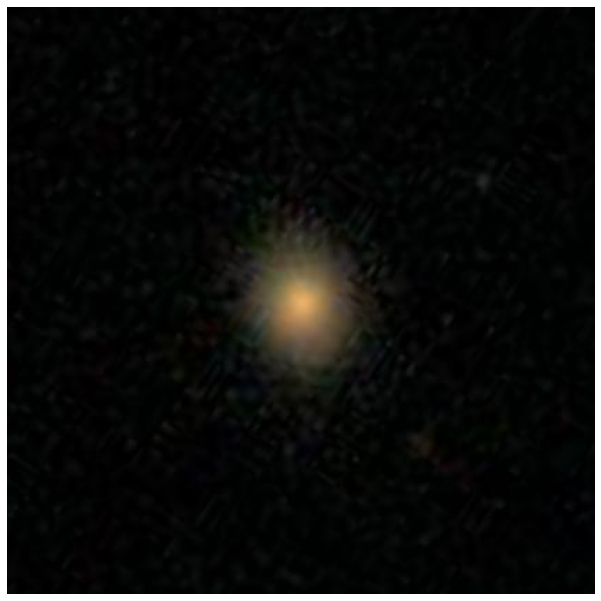

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBFDEF2C890>
(424, 424, 3)


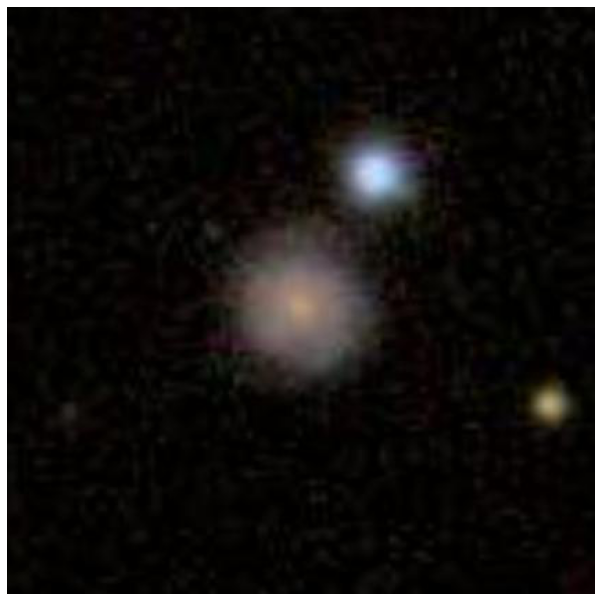

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBFDF100850>
(424, 424, 3)


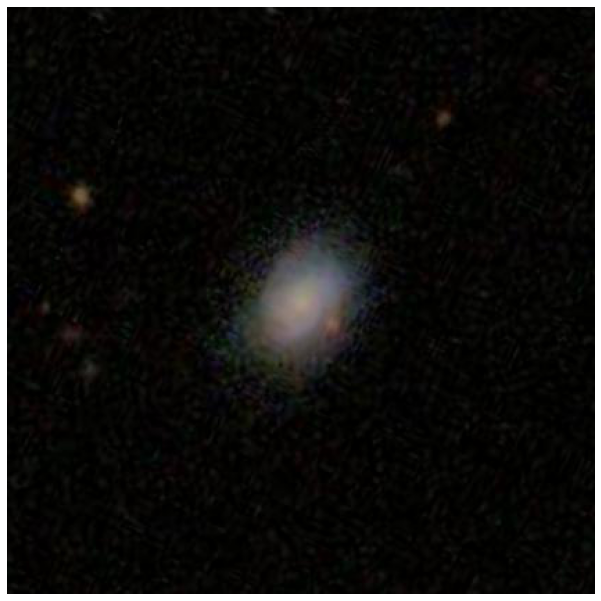

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBF74192A90>
(424, 424, 3)


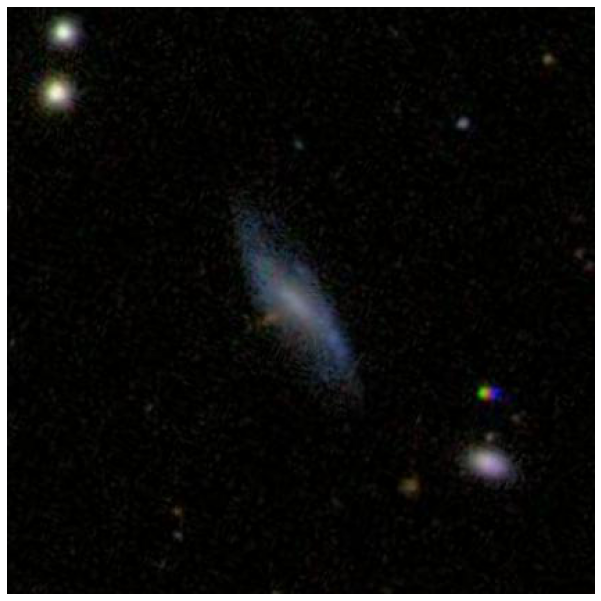

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBF7423D190>
(424, 424, 3)


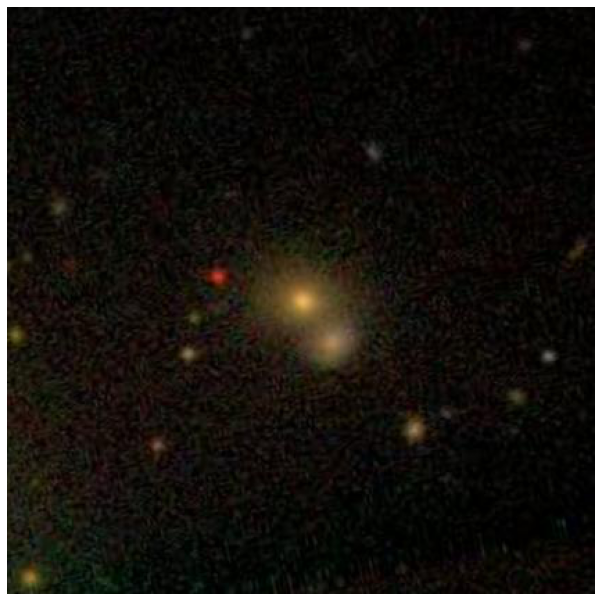

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBC202185D0>
(424, 424, 3)


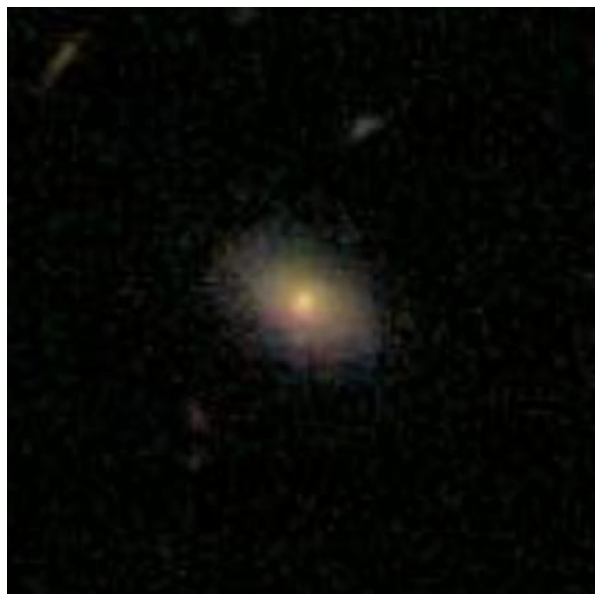

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBF73DA5190>
(424, 424, 3)


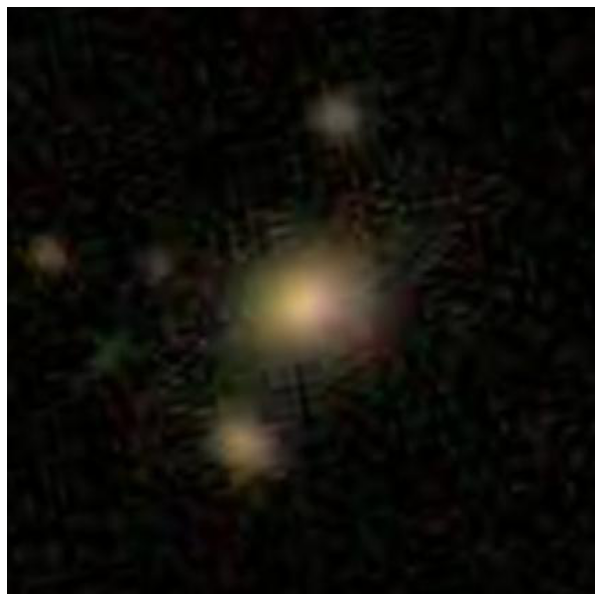

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBF73D99050>
(424, 424, 3)


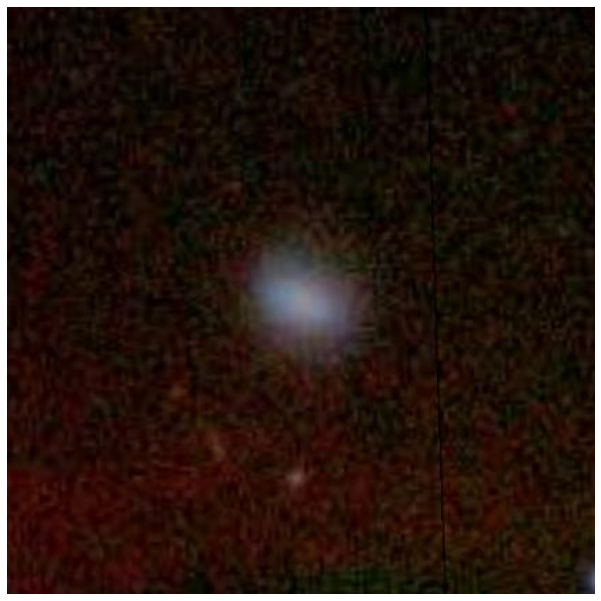

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBDB7194450>
(424, 424, 3)


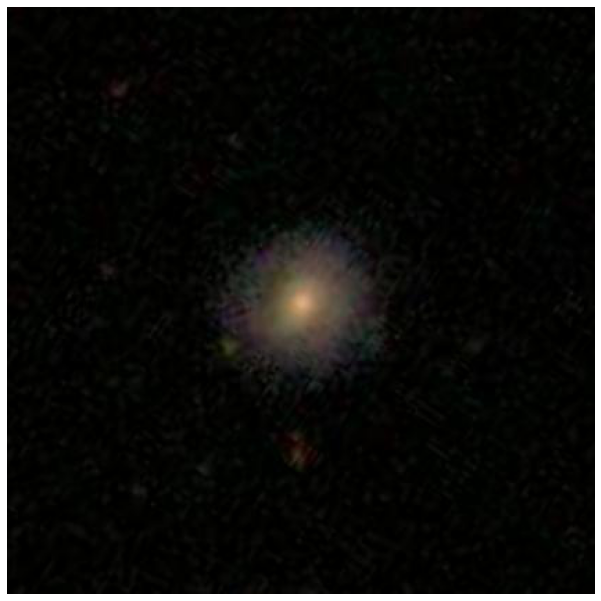

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBDB6AD0190>
(424, 424, 3)


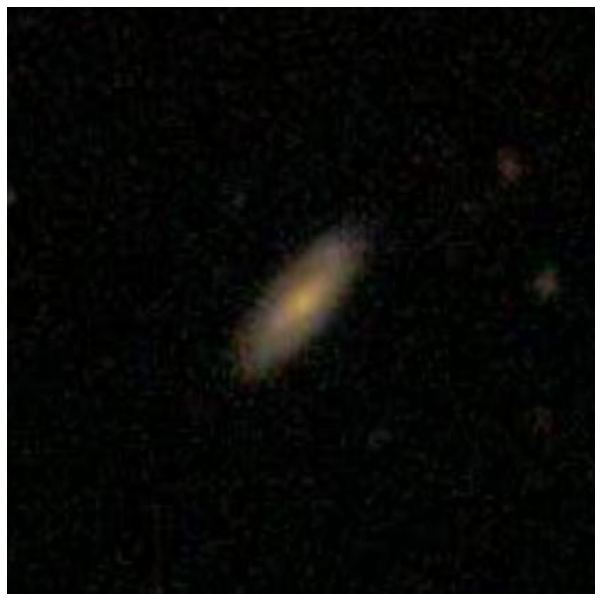

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBFD94C3350>
(424, 424, 3)


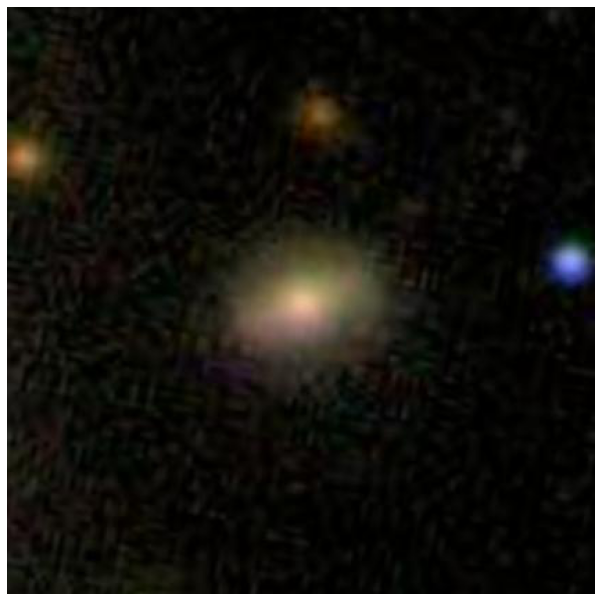

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBF73D84290>
(424, 424, 3)


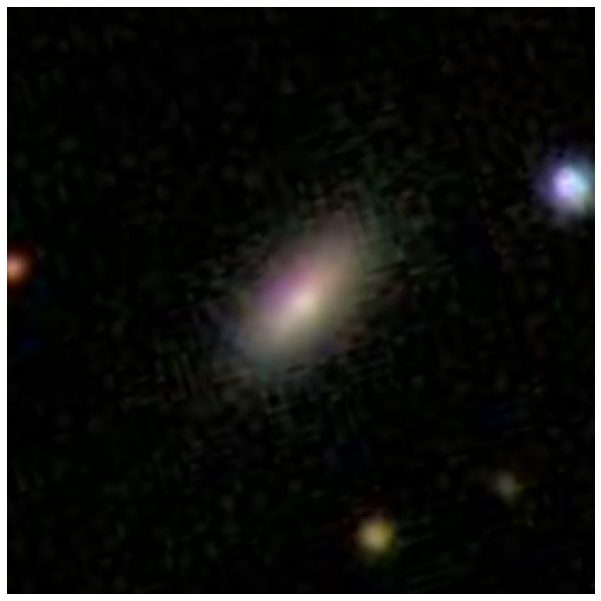

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBFD86034D0>
(424, 424, 3)


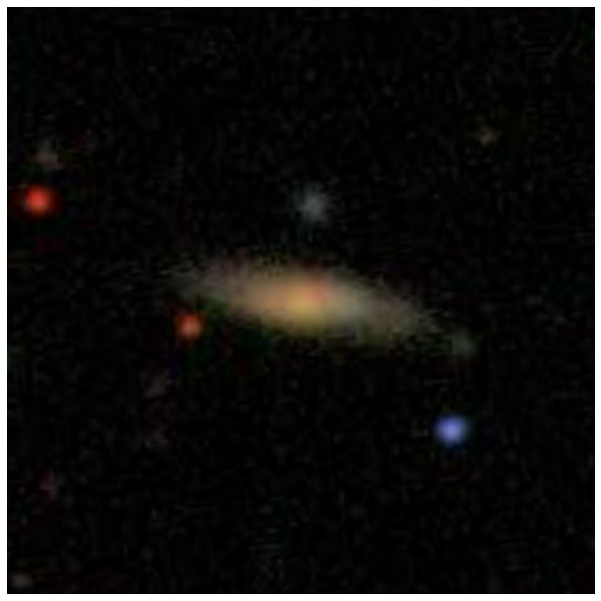

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBF731B6F90>
(424, 424, 3)


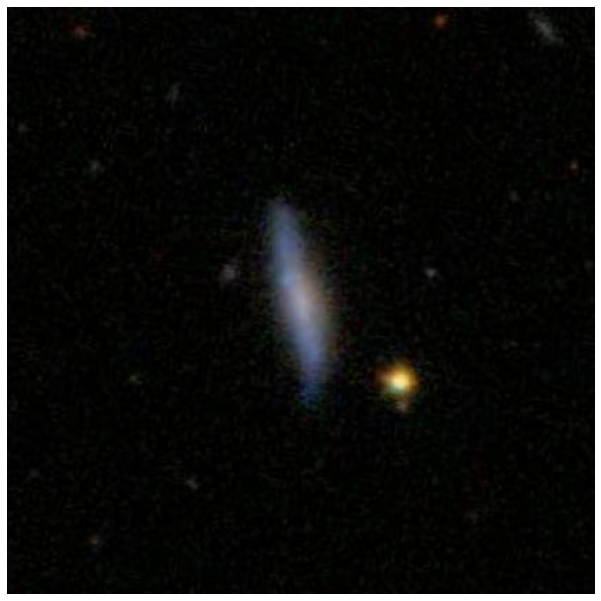

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBDB5E8F150>
(424, 424, 3)


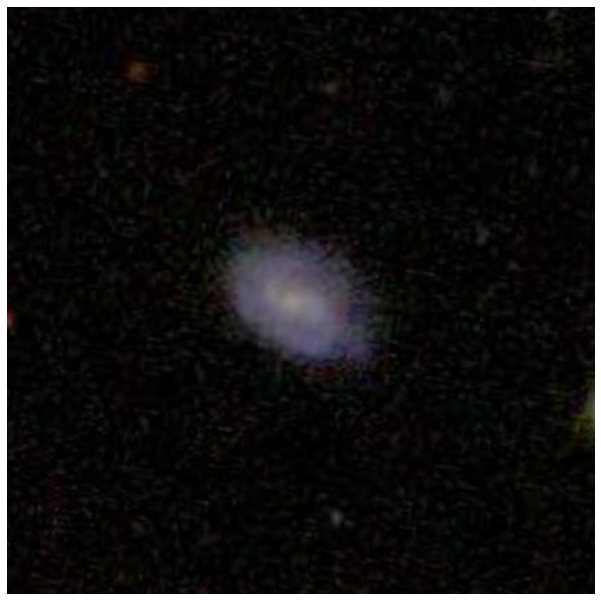

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=424x424 at 0x7FBDB5EA3810>
(424, 424, 3)


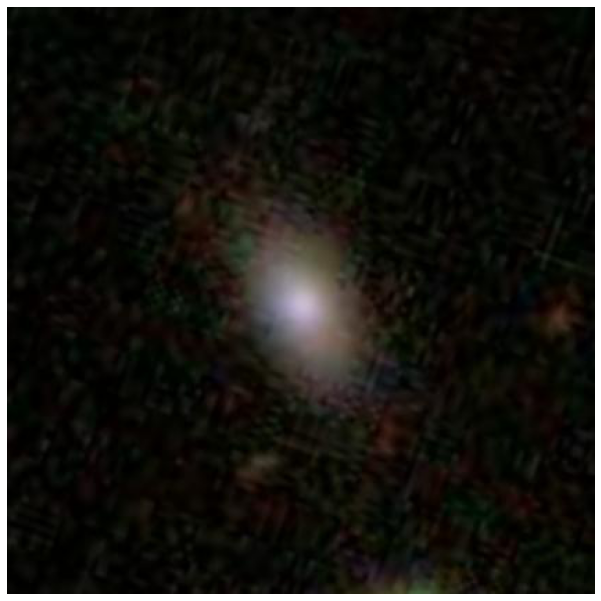

In [104]:
#loop that grabs some random images and displays them

rand_int = 2*np.random.randint(low=4, high=int(len(train_img_list)/50))
i=0
j=0
train_img_list=train_img_list[1:]

for i in range(1,25):
    
    member=train_img_list[(i)*rand_int]
    filename=str(member).split("'")[1]
    image = Image.open(filename)
    print(image)
    plt.figure(figsize=(19.2,10.8))
    read_image = plt.imread(filename)
    print((read_image.shape))
    plt.axis('off')
    plt.imshow(read_image)
    plt.show()

In [104]:
train_data = pd.read_csv('training_classifications.csv')

In [105]:
hdrs = list(train_data)

In [113]:
np.mean(train_data['Class1.3'])

0.025212831384585403

# Shape of distributions

We see below that most of our distributions are skewed fairly heavily from the values displayed in each plot. For a distribution to be a univariate gaussian distribution, the skew value should be as close to zero as possible; yet, we do not see that for most of our distributions. This would indicate that our galaxies are more likely to have certain qualities as opposed to other qualities. In fact, we can see that the mode of quite a few of these labels are an order of magnitude greater than the mean and the median. This might indicate that there is a certain mechanism that causes the galaxies to take on these values. We do see that a few of the distributions could be bimodal. Specifically, Class1.1, Class1.2, Class2.2, Class2.3, and Class4.1 warrant further investigation. If this were the case, this complicates the matters further when analyzing the skewness of these specific distributions. We also see some empty bins between non-empty bins which would indicate that our sampling of galaxies may be incomplete and that there are further galaxies which we could sample to obtain their values. It is also possible that the values of the labels are not entirely accurate as well which would mean that our distributions might not have gaps in them.

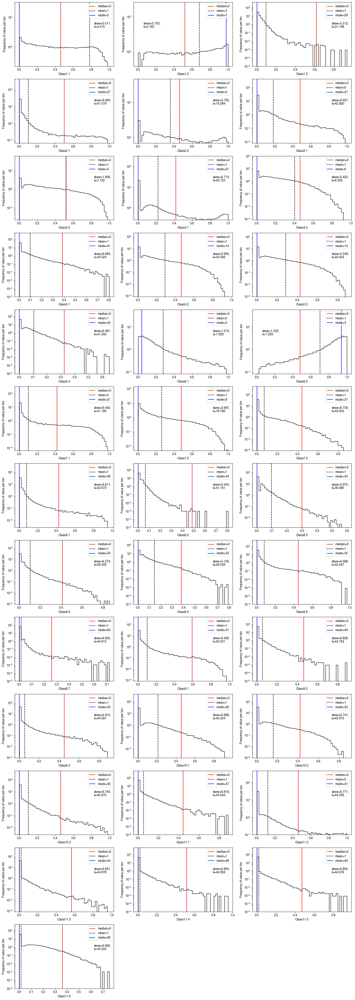

In [32]:
'''
for loop that grabs the data from the csv file and displays the distributions
of the 37 labels in a way that is easy to understand

we display the mean, median, and mode of the normalized distributions
'''

absolute_difference_function = lambda list_value : abs(list_value - given_value)
fig, axes = plt.subplots(nrows=13, ncols=3, figsize=(20,60))
i=0
j=0

#loop through the different columns
for header in hdrs[1:]:
    
    #initialize the plot figure and input the label data and calculate values of interest
    n, bins, _ = axes[i,j].hist(train_data[header], bins=50, histtype='step', color='k', lw=1.2,density=True)
    mean = np.mean(n)
    mode = np.max(n)
    median = np.median(n)
    mn_ind = np.argmin(abs(n-mean))
    mode_ind = np.argmin(abs(n-mode))
    med_ind = np.argmin(abs(n-median))
    n = np.sort(n)
    
    #plot the values of interest
    axes[i,j].set_yscale('log')
    axes[i,j].vlines(bins[med_ind], ymin=0,ymax=20*mode, color='r',label=f'median={int(median)}')
    axes[i,j].vlines(bins[mn_ind], ymin=0,ymax=20*mode, color='k', ls='dashed', label=f'mean={int(mean)}')
    axes[i,j].vlines(bins[mode_ind], ymin=0,ymax=20*mode, color='b', label=f'mode={int(mode)}')
    
    #set the axes bounds
    if np.min(n)==0:
        
        axes[i,j].set_ylim(10**(-5),15*mode)
        
    else:
        
        axes[i,j].set_ylim(np.min(n),15*mode)
        
    if bins[mode_ind]-bins[med_ind] < 0: 

        axes[i,j].annotate(f'skew={stats.skew(n):.3f},\nk={stats.kurtosis(n,fisher=True):.3f}',xy=(0,0),
            xycoords='axes fraction', xytext=(0.8,0.6))


    else:

        axes[i,j].annotate(f'skew={stats.skew(n):.3f},\nk={stats.kurtosis(n,fisher=True):.3f}',xy=(0,0),
            xycoords='axes fraction', xytext=(0.1,0.6))

    #set the labels
    axes[i,j].set_xlabel(f'{header}')
    axes[i,j].set_ylabel('Frequency of value per bin')
    axes[i,j].legend()
    j+=1
    
    if j==3:
        i+=1
        j=0

#get rid of extra plots we don't need
fig.delaxes(axes[12][1])
fig.delaxes(axes[12][2])
plt.show()

# A quick glance at the labels

It appears from a first glance that the labels which could be the easiest to classify are Class1.1, Class1.3, Class8.5, Class8.6, Class10.3, Class11.1, and Class11.5. The labels which could be harder to classify are Class2.1, Class2.2, Class3.1, Class3.2, Class5.1, Class5.2, Class5.4, Class6.2, Class7.1, Class7.2, Class7.3, and Class11.6.

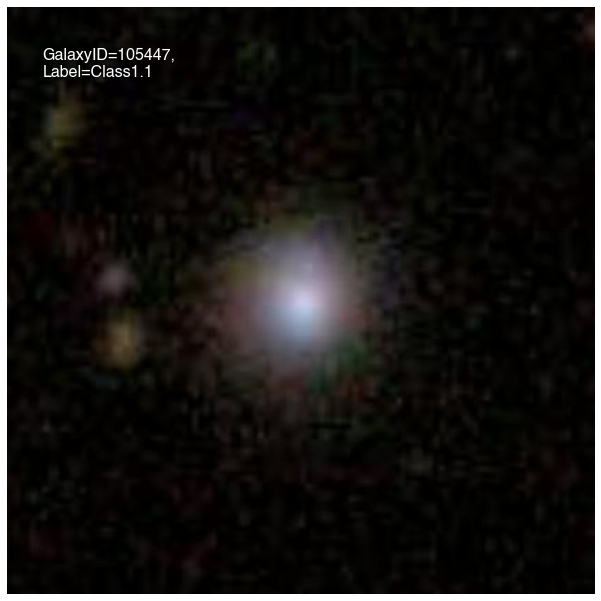

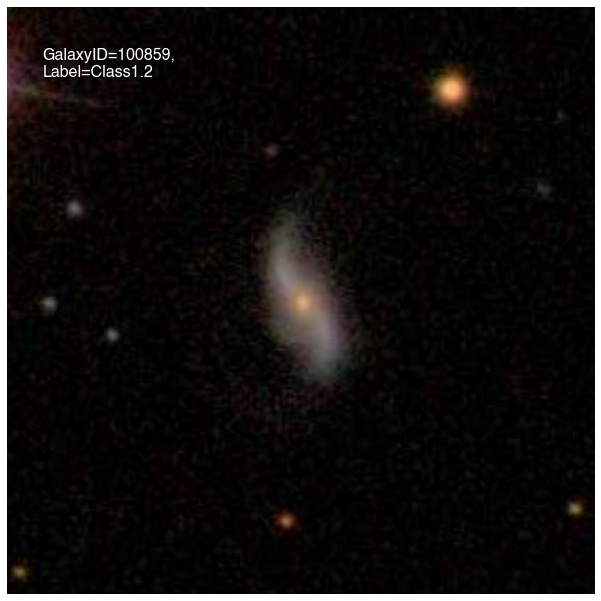

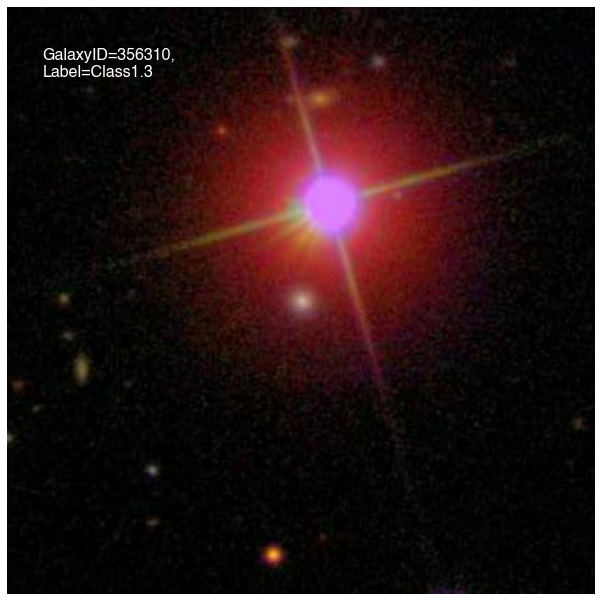

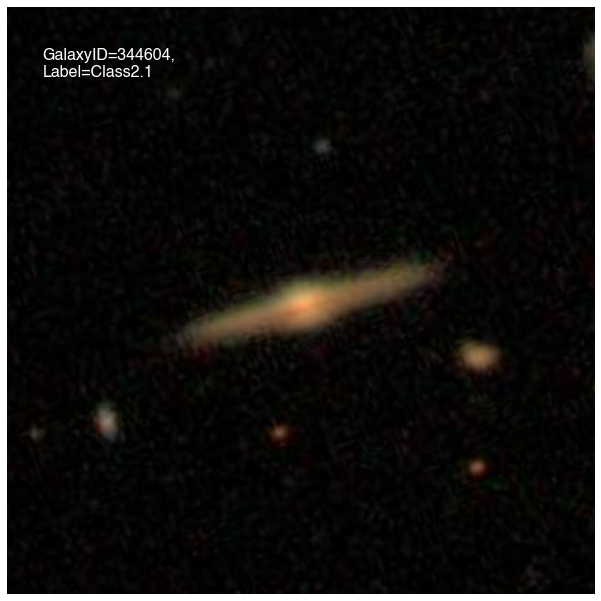

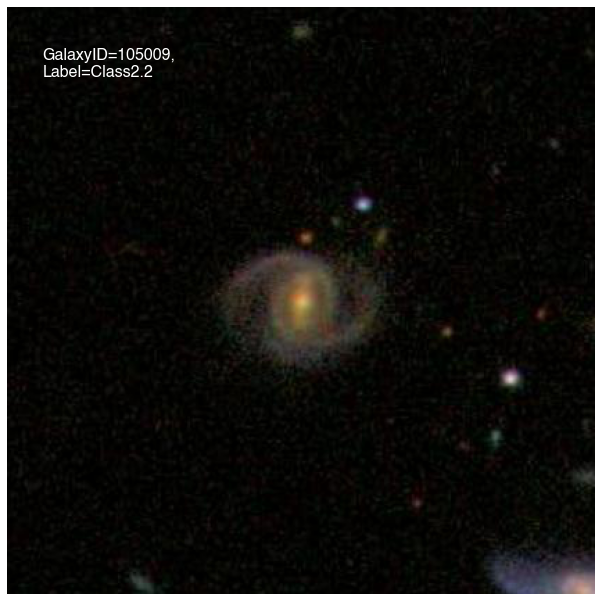

...

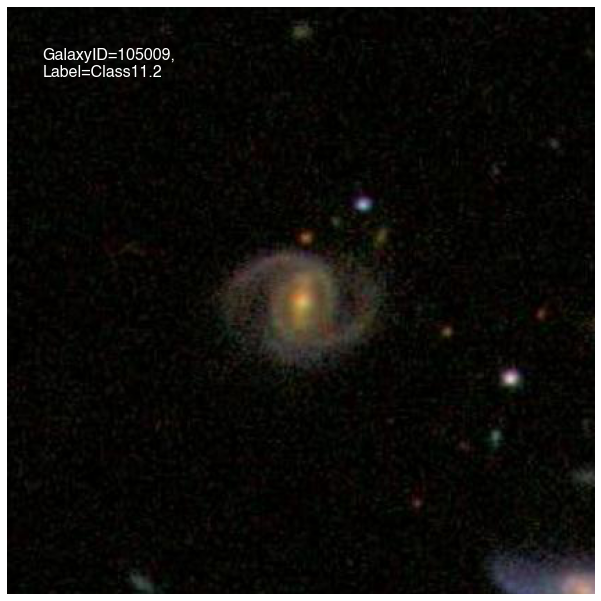

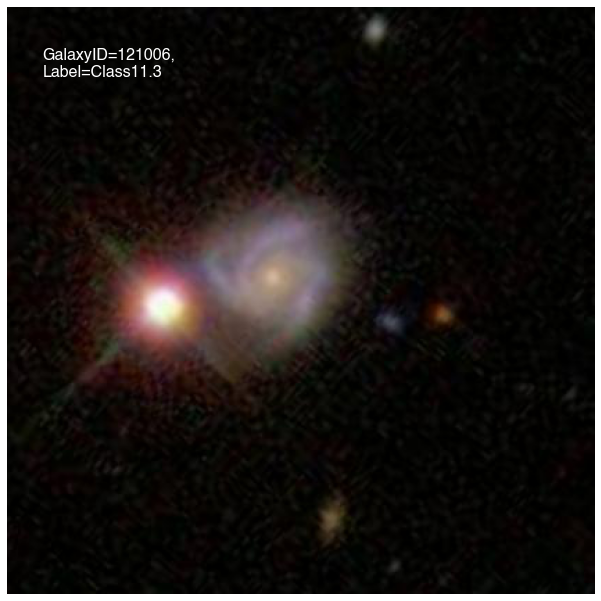

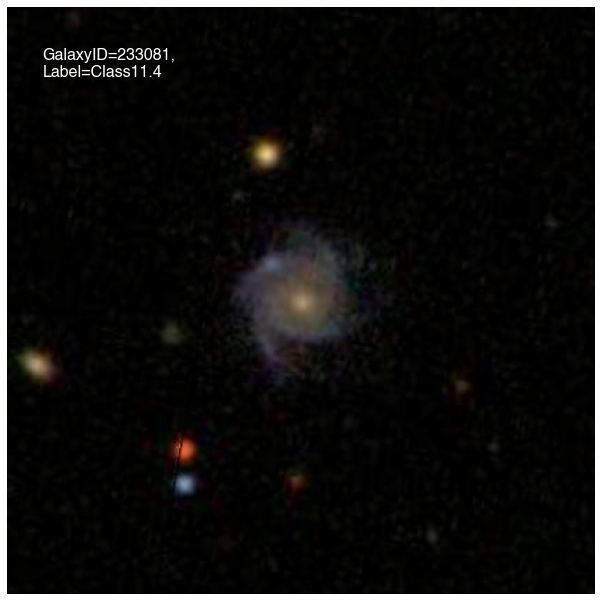

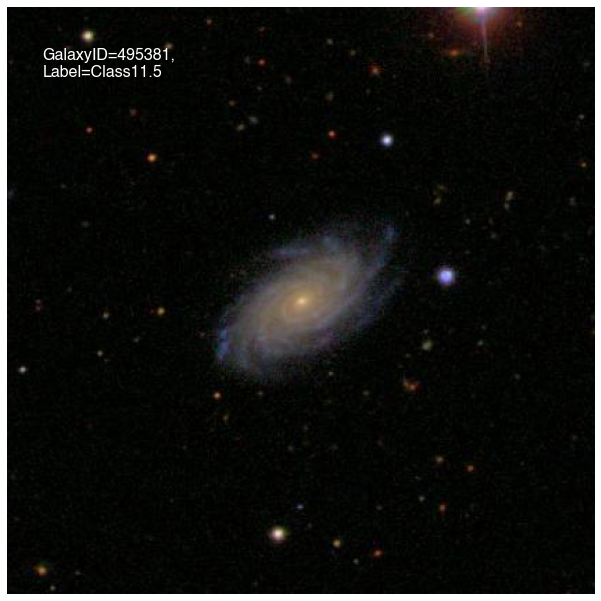

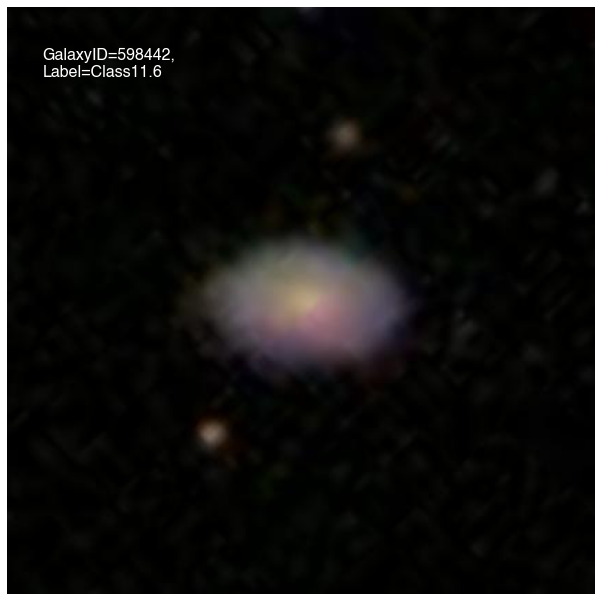

In [107]:
#for loop to show the images with the highest probability of being a certain label
for header in hdrs[1:]:
    
    ID=train_data['GalaxyID'][np.argmax(train_data[header])]
    filename='training_images/'+str(ID)+'.jpg'
    plt.figure(figsize=(19.2,10.8))
    read_image = plt.imread(filename)
    plt.axis('off')
    plt.imshow(read_image)
    plt.text(25,50,s=f'GalaxyID={ID},\nLabel={header}',color='white',fontsize=16)
    plt.show()

In [7]:
#initialize correlation matrix 
cor_mat = np.zeros((37,37))
i=0
j=0

#double for loop to calculate coviarances for each label
for header_i in hdrs[1:]:
    
    for header_j in hdrs[1:]:
        
        ij_avg = np.mean(train_data[header_i]*train_data[header_j])
        avg_ij = np.mean(train_data[header_i])*np.mean(train_data[header_j])
        i2_avg = np.mean(train_data[header_i]**2)
        avg_i2 = np.mean(train_data[header_i])**2
        j2_avg = np.mean(train_data[header_j]**2)
        avg_j2 = np.mean(train_data[header_j])**2
        cor_mat[i][j]=(ij_avg-avg_ij)/(np.sqrt(i2_avg-avg_i2)*np.sqrt(j2_avg-avg_j2))
        j+=1
    
    i+=1
    j=0

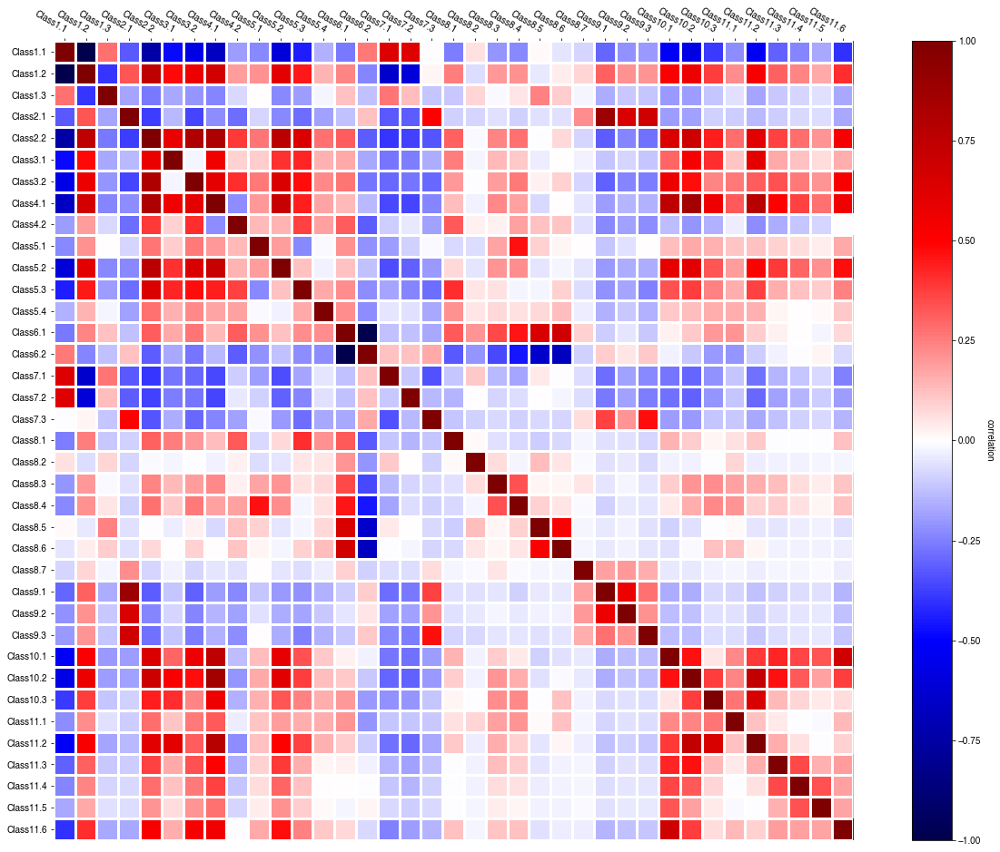

In [8]:
#plot each of the correlations in a matrix form with a heatmap 
fig, ax = plt.subplots(figsize=(23.04,16.2))
im, cbar = heatmap(cor_mat, hdrs[1:], hdrs[1:], ax=ax,
                   cmap="seismic", cbarlabel="correlation")

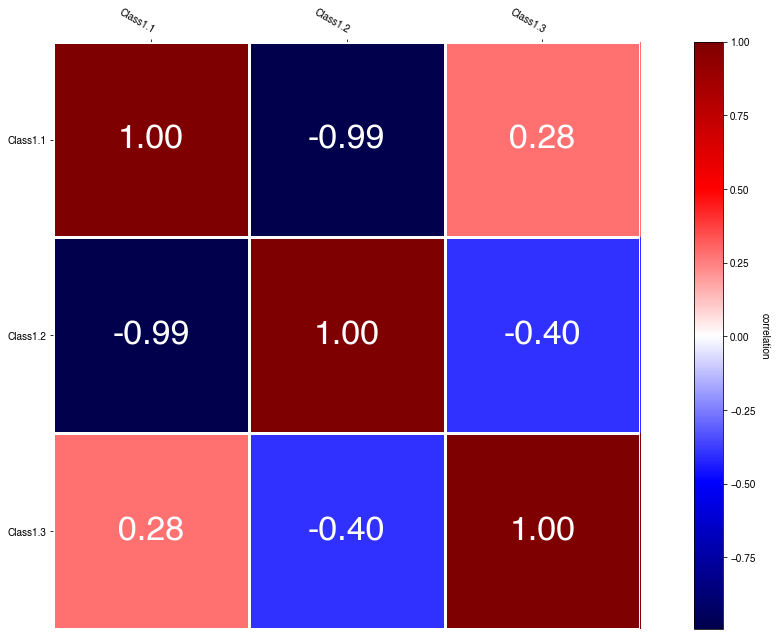

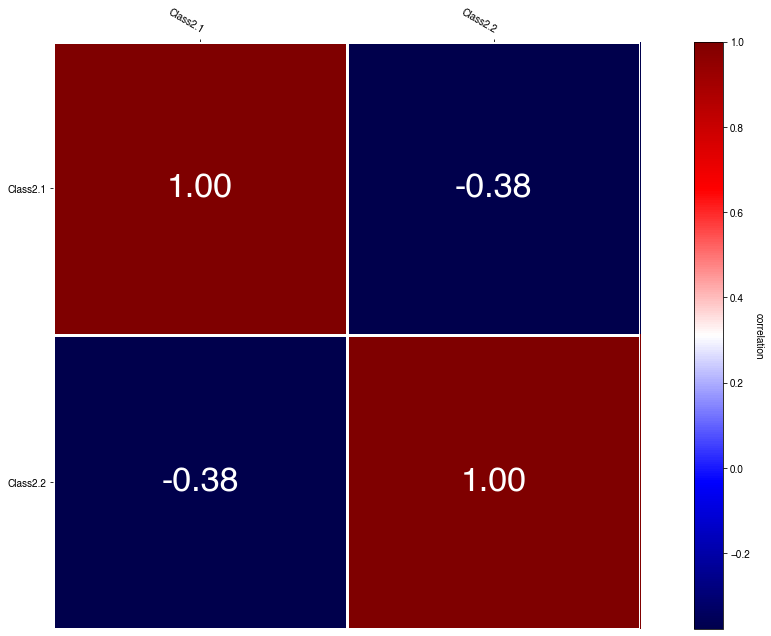

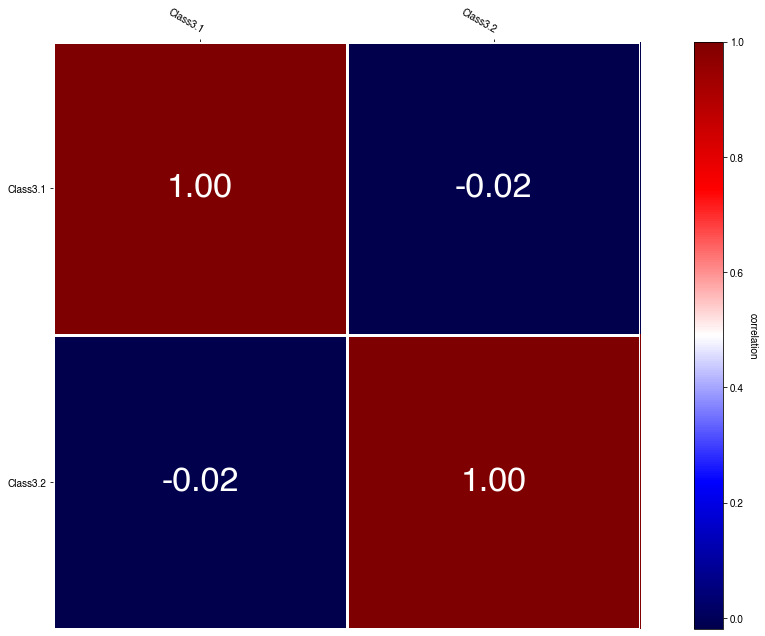

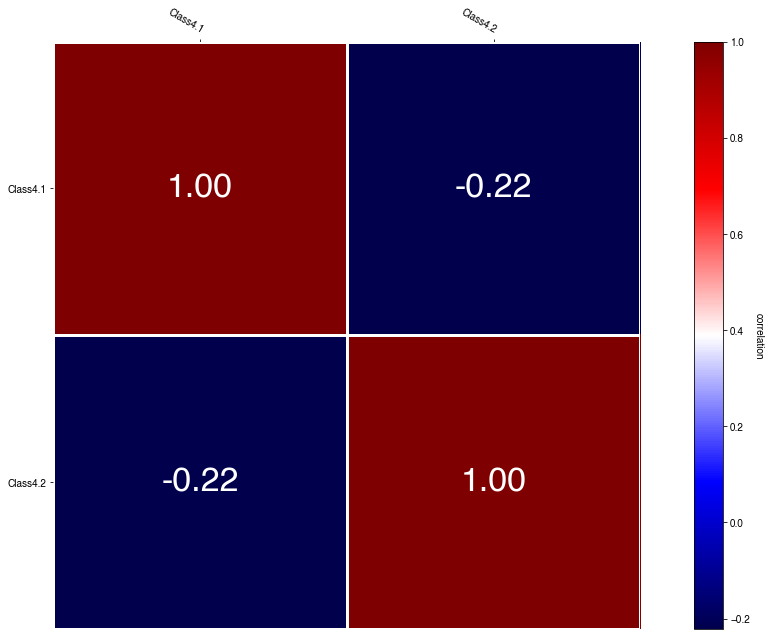

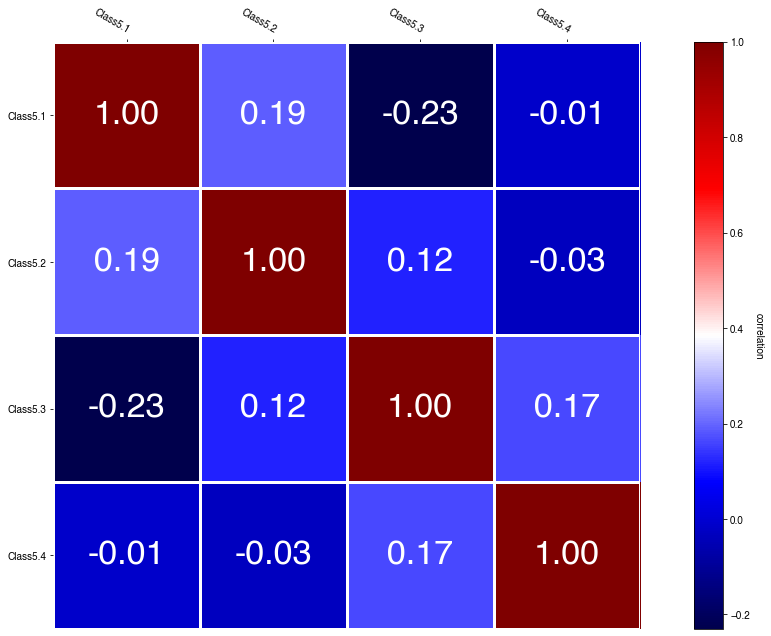

...

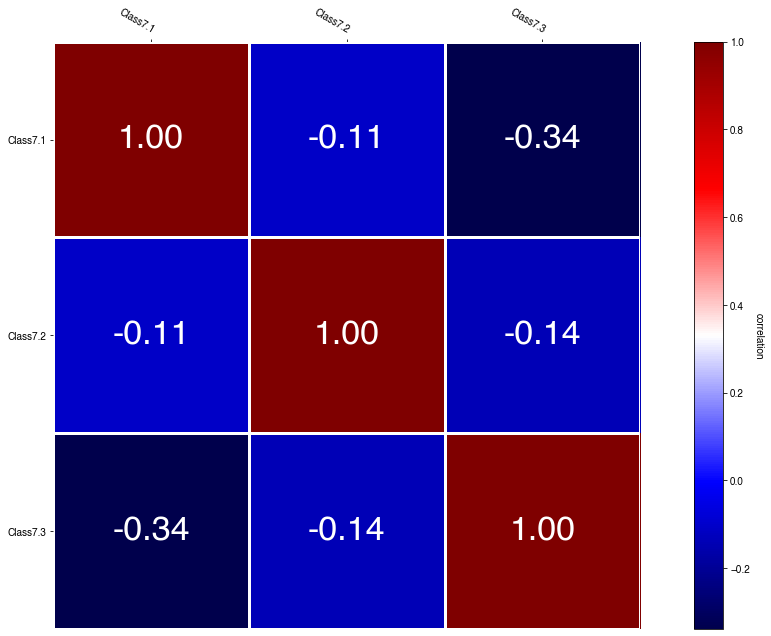

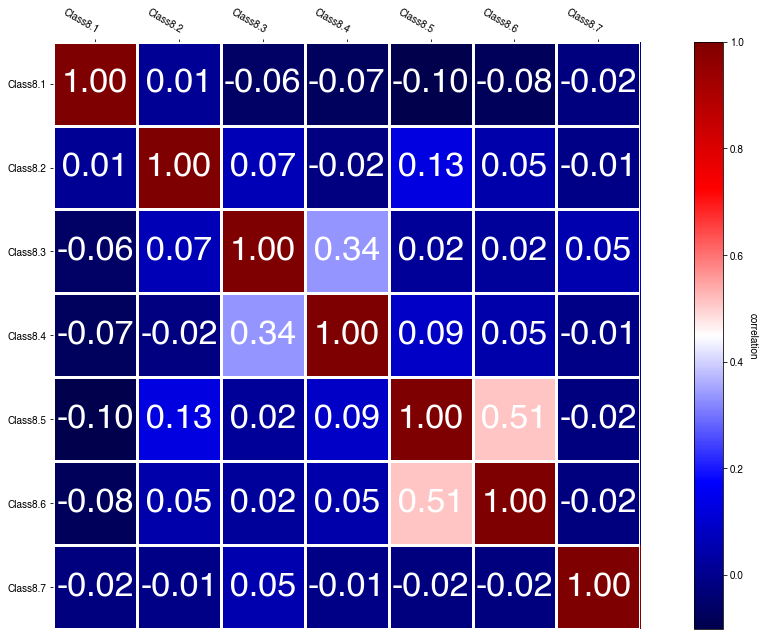

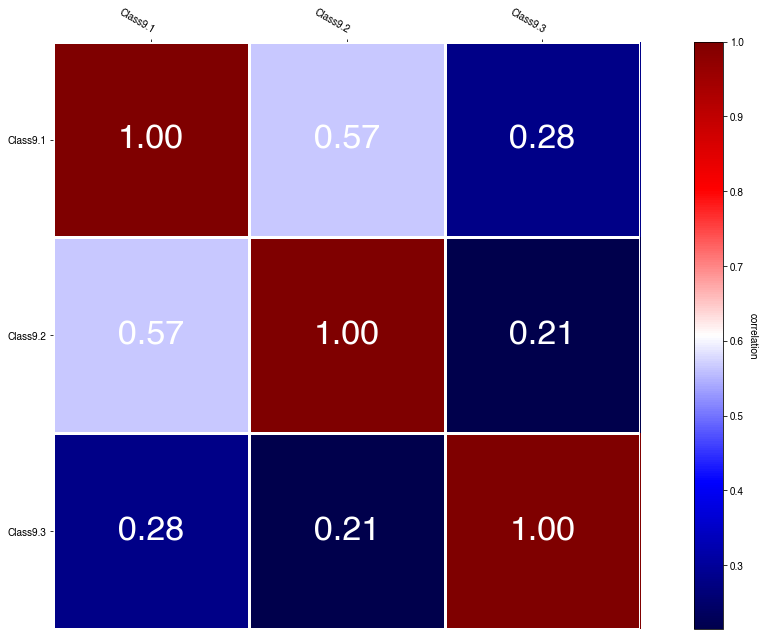

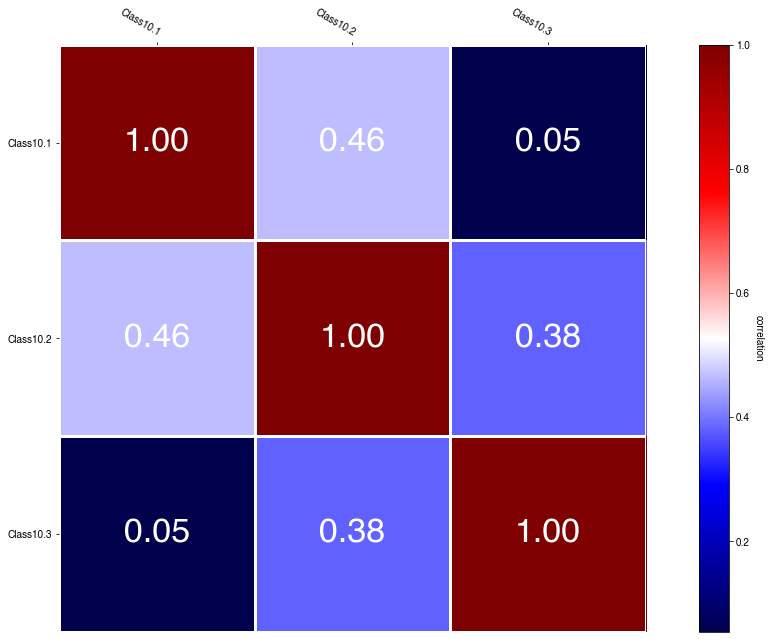

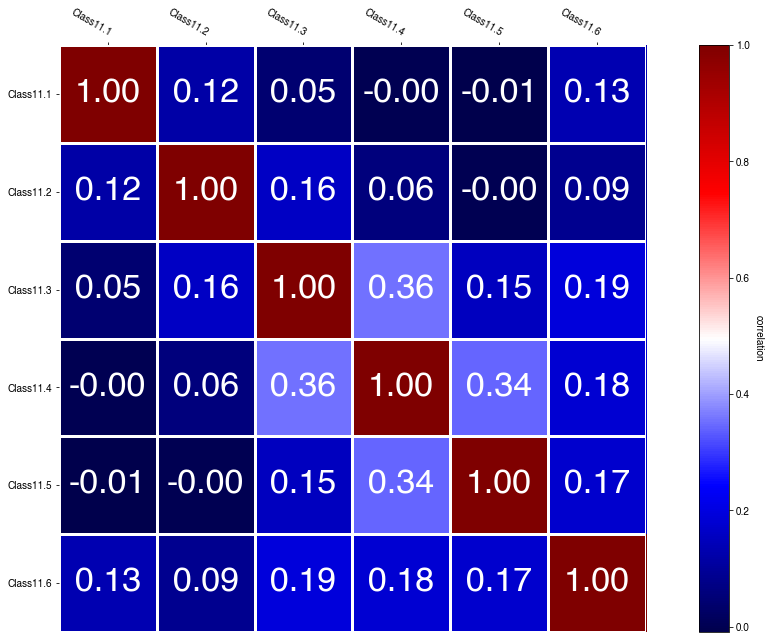

In [9]:
c_inds=[(0,2),(3,4),(5,6),(7,8),(9,12),(13,14),(15,17),(18,24),(25,27),(28,30),(31,36)]

#for loop to display the submatrices for each class to show what they look like in detail
for i in range(len(c_inds)):
    
    low=c_inds[i][0]
    high=c_inds[i][1]
    temp=cor_mat[low:high+1]
    fig, ax = plt.subplots(figsize=(19.2,10.8))
    im, cbar = heatmap(cor_mat[low:high+1,low:high+1], hdrs[low+1:high+2], hdrs[low+1:high+2],
                       ax=ax,cmap="seismic", cbarlabel="correlation")
    texts = annotate_heatmap(im, threshold=-1.01,size=34, valfmt="{x:.2f}")
    plt.show()

0.4965


In [86]:
red_img_bool=True

#for loop that reduces images to make them usable for a generator for training
for ID in train_data['GalaxyID']:
    
    filename='training_images/'+str(ID)+'.jpg'

    #using Image library for reduction
    with Image.open(filename) as im:

        box=(106,106,318,318)
        im_copy=im.crop(box=box)
        im_copy=im_copy.resize((64,64))
        
        if red_img_bool:

            im_copy.save(f'reduced_training_images/{ID}.jpg', 'JPEG')

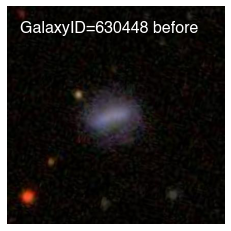

(64, 64)


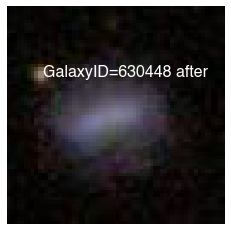

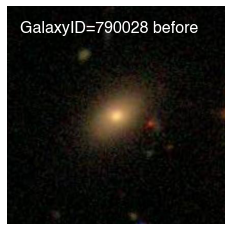

(64, 64)


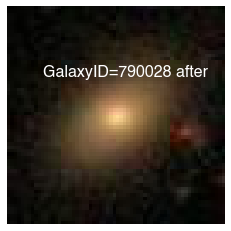

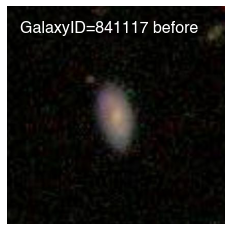

(64, 64)


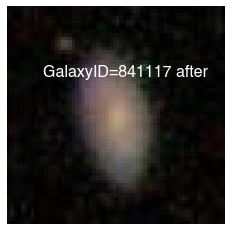

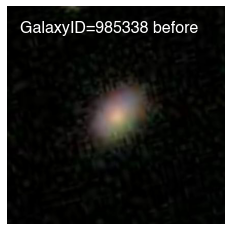

(64, 64)


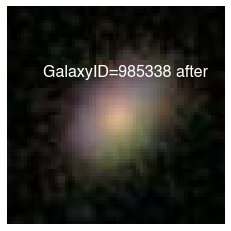

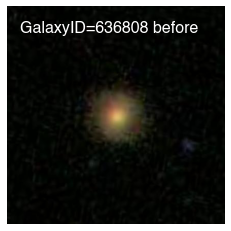

(64, 64)


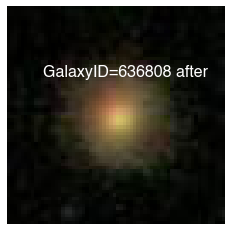

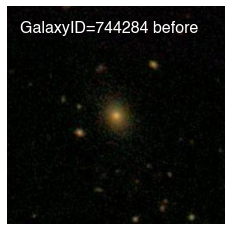

(64, 64)


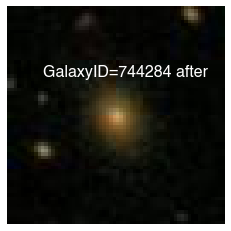

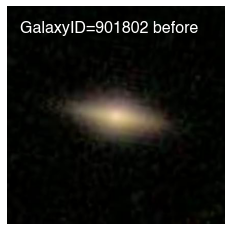

(64, 64)


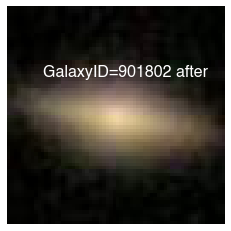

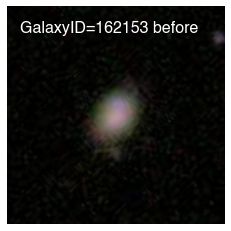

(64, 64)


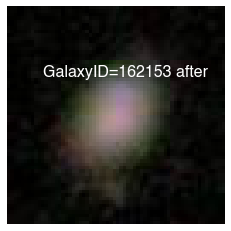

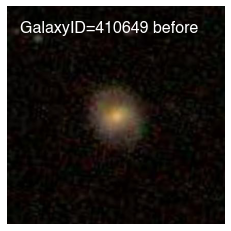

(64, 64)


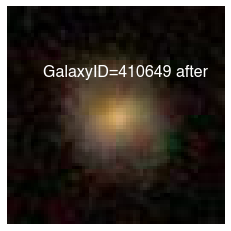

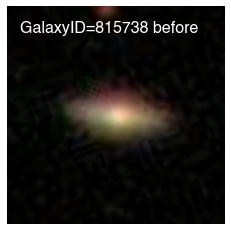

(64, 64)


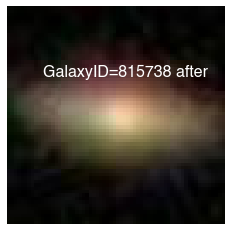

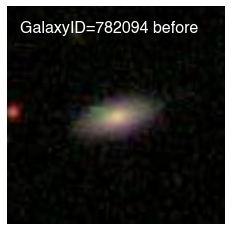

(64, 64)


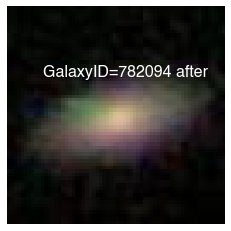

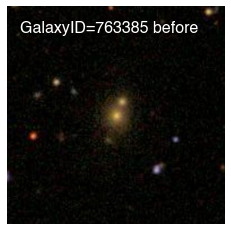

(64, 64)


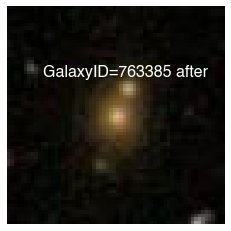

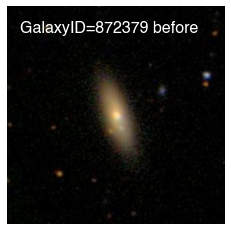

(64, 64)


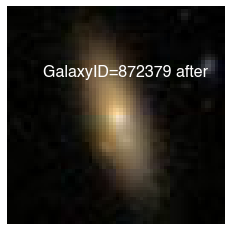

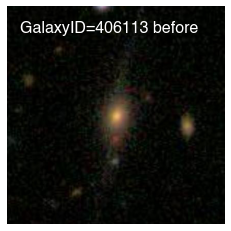

(64, 64)


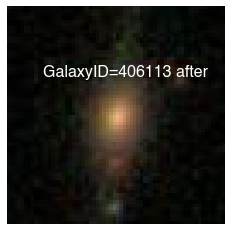

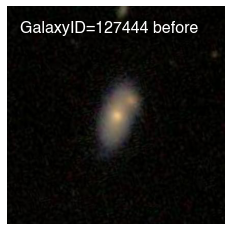

(64, 64)


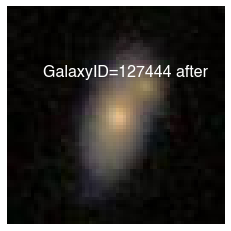

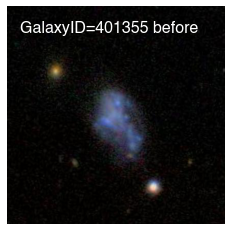

(64, 64)


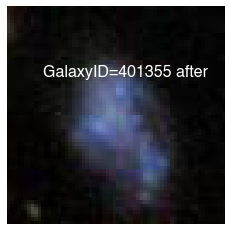

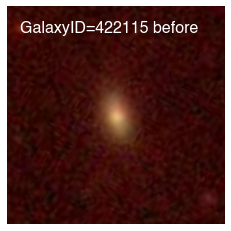

(64, 64)


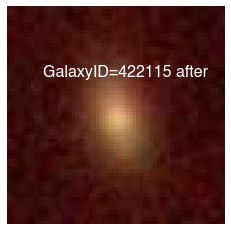

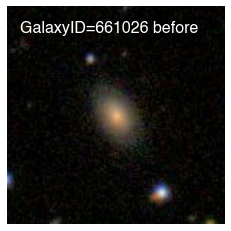

(64, 64)


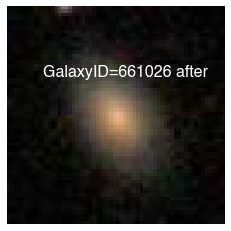

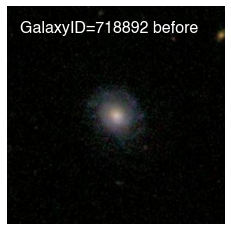

(64, 64)


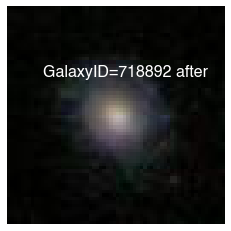

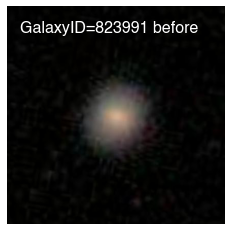

(64, 64)


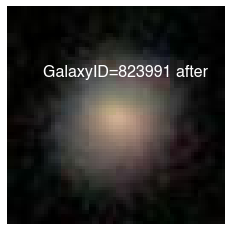

In [87]:
rand_ints=np.random.randint(low=1, high=61577, size=20)

#for loop that displays random images before and after scaling
for ind in rand_ints:
    
    ID = train_data['GalaxyID'][ind]
    filename='training_images/'+str(ID)+'.jpg'
    read_image = plt.imread(filename)
    plt.axis('off')
    plt.imshow(read_image)
    plt.text(25,50,s=f'GalaxyID={ID} before',color='white',fontsize=16)
    plt.show()
    plt.axis('off')
    read_image_red = plt.imread('reduced_training_images/'+str(ID)+'.jpg')
    image = Image.open('reduced_training_images/'+str(ID)+'.jpg')
    print(image.size)
    plt.imshow(read_image_red)
    plt.text(5,10,s=f'GalaxyID={ID} after',color='white',fontsize=16)
    plt.show()

# You forgot about the memory! (Doh!)

We could be rash about our decision to load all of these images into our model at once. We wouldn't have a fun time and neither would our computer. The reason for this is that to load each of these images requires a lot of memory. Each image has been resized to be a 80x80 pixel RGB image. To calculate how many bytes that is, we need to consider that each pixel is one unit of 3 RGB bytes. Thus, to see how many bytes each image is, we take the product $$80 \times 80 \times 3 = 0.0192 \textrm{ MB}.$$ On their own, each image takes up very little memory, yet we have 61577 images which means that we are actually dealing with $$61578 \times 80 \times 80 \times 3 \approx 1.18 \textrm{ GB}$$ which is quite a lot of memory at once to deal with. Before resizing our images we would have been loading $$61577 \times 424 \times 424 \times 3 =\textbf{33.2 GB}$$ into our computer's memory at once!

In [59]:
#custom generator function
def csv_generator():
    
    #open the csv file
    open_file = open('training_classifications.csv')
    #skip over the header information
    header = next(open_file)
    
    #go through each row
    for row in open_file:
        
        #split the rows and adjust the last element to remove the extra newline
        row = row.split(",")
        row[-1] = row[0][-1].split("\n")[0]
        ind = np.where(train_data['GalaxyID']==int(row[0]))[0][0]
        
        #read in the image data based on the index
        img = np.array(plt.imread(f"reduced_training_images/{train_data['GalaxyID'][ind]}.jpg"))
        
        #loop through each of the columns in the row to grab the data
        for i in range(len(row)):
            
            row[i] = float(row[i])
            
        #set the data to a numpy array
        row=np.array(row)
        
        #yield the data so that we don't lose our place when running through the file
        yield np.array([row, img], dtype=object)

In [60]:
#set this to an np array
train_data = np.asarray(train_data)

In [61]:
#initialize random list of integers
import time
np.random.seed(int(time.time()))
rand_inds = np.random.randint(low=0,high=61577,size=61578)
rand_ratio = 0.8
#initialize empty dictionaries that will contain IDs and labels
partition = {'train': [], 'validation': []}
labels = {}
accept=0
i=1

#for loop to run through the random indices
for ind in rand_inds:

    #if condition determines whether that random index is selected
    if accept/i < rand_ratio:

        #add data to created data structures
        rand_data=train_data[ind]
        ID = int(rand_data[0])
        partition['train'].append(ID)
        labels[f'{ID}'] = rand_data[1:]
        accept+=1

    else:

        #add data to data structures
        rand_data=train_data[ind]
        ID = int(rand_data[0])
        partition['validation'].append(ID)
        labels[f'{ID}'] = rand_data[1:]
        
    i+=1
    
#remove the training data from the local memory so it doesn't affect performance            
del train_data

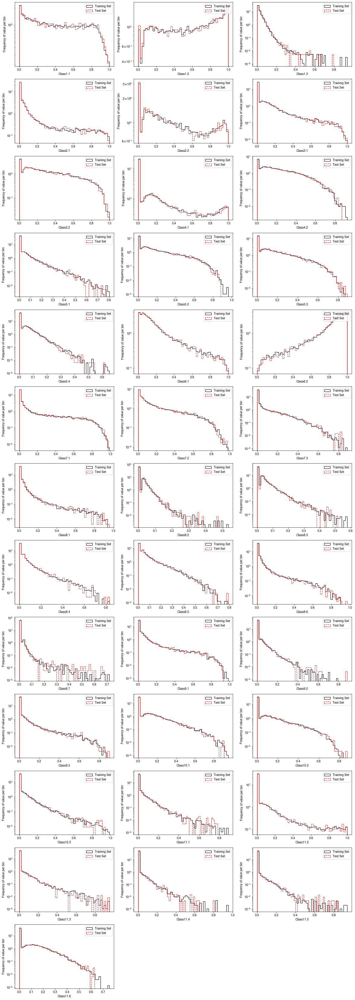

In [62]:
#initialize labels lists
train_labels=[]
validation_labels=[]

#for loops to grab labels based on Galaxy IDs
for ID in partition['train']:
    
    train_labels.append(labels[str(ID)])
    
for ID in partition['validation']:
    
    validation_labels.append(labels[str(ID)])
    
#transpose the arrays so each row corresponds to one label
train_labelsT = np.matrix.transpose(np.array(train_labels))
validation_labelsT = np.matrix.transpose(np.array(validation_labels))

i=0
j=0

#initialize subplots of a figure
fig, axes = plt.subplots(nrows=13, ncols=3, figsize=(20,60))

#for loop displaying distributions for training and validation data
for t_labels, v_labels, hdr in zip(train_labelsT, validation_labelsT, hdrs[1:]):
    
    #graph distribution of training labels
    n, bins, _ = axes[i,j].hist(t_labels, bins=50, histtype='step', color='k',
                                lw=1.2,density=True,label='Training Set')
    #graph distribution of validation labels
    n_test, bins_test, _ = axes[i,j].hist(v_labels, bins=50, histtype='step',color='r',
                                         lw=1.2,ls='dashed',density=True, label='Test Set')
    
    
    #set graph scales and print the legend for readability
    axes[i,j].set_yscale('log')
    axes[i,j].set_xlabel(f'{hdr}')
    axes[i,j].set_ylabel('Frequency of value per bin')
    axes[i,j].legend()
    j+=1
    
    if j==3:
        i+=1
        j=0

#delete unnecessary axes
fig.delaxes(axes[12][1])
fig.delaxes(axes[12][2])
plt.show()

In [63]:
import tensorflow.keras.backend as K

#defines root mean squared loss function
def rmse(l_pred, l_true):
    
    return tf.sqrt(tf.reduce_mean(tf.square(tf.subtract(l_true, l_pred))))

In [67]:
#this class is a subclass of the keras Sequence class
class DataGenerator(tf.keras.utils.Sequence):

    #initializes an instantiation of the class
    def __init__(self, list_IDs, labels, labels_dim=37, batch_size=None, dim=(38,1), n_channels=1,
                 n_classes=10, shuffle=True, folder_name=None, augment=False, unaugmented_dim=(424,424)):
        
        'Initialization'
        self.folder_name = folder_name
        self.dim = dim
        self.labels_dim = labels_dim
        self.batch_size = batch_size
        self.labels = labels
        self.list_IDs = list_IDs
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.shuffle = shuffle
        self.shape = dim
        self.on_epoch_end()
        self.augment = augment
        self.unaugmented_dim = unaugmented_dim
        
    #public method that shuffles data so the neural net doesn't see the same sequence of images    
    def on_epoch_end(self):
        
        'Updates indexes after each epoch'
        
        self.indexes = np.arange(len(self.list_IDs))
        
        if self.shuffle == True:
            
            np.random.shuffle(self.indexes)
    
    #private method which generates the batches of image and label data
    def __data_generation(self, list_IDs_temp):
        
        'Generates data containing batch_size samples' # X : (n_samples, *dim, n_channels)
        
        #initialization for augmented images
        if self.augment:
            
            X = np.empty((self.batch_size, *self.dim, self.n_channels))
            y = np.empty((self.batch_size, self.labels_dim))
            
            #runs through the IDs grabbed by __get_item__ to grab images, augment, and resize them
            for i, ID in enumerate(list_IDs_temp):
                
                box=(106,106,318,318)
                
                with Image.open(f'{self.folder_name}' + str(ID) + '.jpg') as im:
                    
                    im_copy = im.rotate(np.random.randint(low=0,high=360))
                    im_cropped = im_copy.crop(box=box)
                    new_im = np.asarray(im_cropped.resize((64,64)))
                    
                    X[i,] = new_im
                    y[i] = self.labels[str(ID)]
            
        else:
        
            X = np.empty((self.batch_size, *self.dim, self.n_channels))
            y = np.empty((self.batch_size, self.labels_dim))

            #runs through the IDs grabbed by __get_item__ to grab images
            for i, ID in enumerate(list_IDs_temp):

                X[i,] = plt.imread(f'{self.folder_name}' + str(ID) + '.jpg')

                # Store classes
                y[i] = self.labels[str(ID)]
        
        #calculate mean and standard deviation to normalize images
        avg=np.mean(X)
        std=np.std(X)

        return (X-avg)/std, y
    
    #private method to determine number of batches per epoch
    def __len__(self):
        
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.list_IDs) / self.batch_size))
    
    #private method to generate list of IDs used to grab data
    def __getitem__(self, index):
        
        'Generate one batch of data'
        # Generate indexes of the batch
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]

        # Find list of IDs
        list_IDs_temp = [self.list_IDs[k] for k in indexes]

        # Generate data
        X, y = self.__data_generation(list_IDs_temp)

        return X, y

In [65]:
#subclass of keras Callback class to plot metrics
class PlotLosses(tf.keras.callbacks.Callback):
    
    #public method which initializes lists and generates a figure
    def on_train_begin(self, logs={}):
        
        self.i = 0
        self.x = []
        self.losses = []
        self.val_losses = []
        
        self.fig = plt.figure()
        
        self.logs = []

    #public method which uses the data obtained from the NN and creates the figure from it
    def on_epoch_end(self, epoch, logs={}):
        
        self.logs.append(logs)
        self.x.append(self.i)
        self.losses.append(logs.get('loss'))
        self.val_losses.append(logs.get('val_loss'))
        self.i += 1
        
        clear_output(wait=True)
        plt.plot(self.x, self.losses, label="loss", color='k')
        plt.plot(self.x, self.val_losses, label="val_loss", color='r', ls='dashed')
        plt.xlabel('epoch')
        plt.ylabel('loss')
        plt.title('rmse as a function of epoch')
        plt.legend()
        plt.show();

#creating an instantiation of the subclass above
plot_losses = PlotLosses()

# What is our model and how does it match up?

Our model's architecture is a variant of the popular VGG-16 architecture. The reason we used this architecture is that it provides numerous convolutional layers and downsampling layers to images to extract higher level features that are present in image classification problems. Additionally, a variant of the VGG-16 architecture has performed well on galaxy morphology classification previously [Castillo, Shukla, Wright](https://diegocasmo.github.io/files/convolutional_neural_networks_for_galaxy_morphology_classification.pdf).

In our architecture, we first include two convolutional layers with 16 filters, a max pooling layer, two convolutional layers with 32 filters, a max pooling layer, three convolutional layers with 64 filters, a max pooling layers, three convolutional layers with 128 filters, a final max pooling layer, and then two fully connected layers (one with 2048 units and one with 1024 units) with dropouts of $20\%$ following and the final fully connected layer which reduces the number of parameters to 37 which matches the number of categories which a galaxy can fall into.

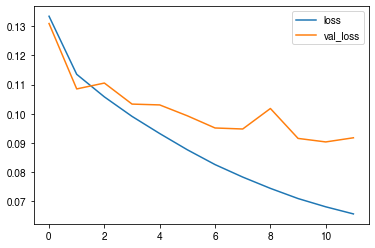

492/492 [==============================] - 1371s 3s/step - loss: 0.0656 - root_mean_squared_error: 0.0657 - val_loss: 0.0917 - val_root_mean_squared_error: 0.0919


In [81]:
model = tf.keras.Sequential()

model.add(Conv2D(input_shape=(64,64,3),filters=16,kernel_size=(3,3),padding="same", activation="relu"))
model.add(layers.BatchNormalization())
model.add(Conv2D(filters=16,kernel_size=(3,3),padding="same"))
model.add(layers.Activation('relu'))
model.add(layers.BatchNormalization())
model.add(layers.MaxPool2D(pool_size=(2,2),strides=(2,2), padding='same'))
model.add(Conv2D(filters=32,kernel_size=(3,3),padding="same"))
model.add(layers.Activation('relu'))
model.add(layers.BatchNormalization())
model.add(Conv2D(filters=32,kernel_size=(3,3),padding="same"))
model.add(layers.Activation('relu'))
model.add(layers.BatchNormalization())
model.add(layers.MaxPool2D(pool_size=(2,2),strides=(2,2), padding='same'))
model.add(Conv2D(filters=64,kernel_size=(3,3),padding="same"))
model.add(layers.Activation('relu'))
model.add(layers.BatchNormalization())
model.add(Conv2D(filters=64,kernel_size=(3,3),padding="same"))
model.add(layers.Activation('relu'))
model.add(layers.BatchNormalization())
model.add(Conv2D(filters=64,kernel_size=(3,3),padding="same"))
model.add(layers.Activation('relu'))
model.add(layers.MaxPool2D(pool_size=(2,2),strides=(2,2), padding='same'))
model.add(Conv2D(filters=128,kernel_size=(3,3),padding="same"))
model.add(layers.Activation('relu'))
model.add(layers.BatchNormalization())
model.add(Conv2D(filters=128,kernel_size=(3,3),padding="same"))
model.add(layers.Activation('relu'))
model.add(layers.BatchNormalization())
model.add(Conv2D(filters=128,kernel_size=(3,3),padding="same"))
model.add(layers.Activation('relu'))
model.add(layers.MaxPool2D(pool_size=(2,2),strides=(2,2), padding='same'))
model.add(Conv2D(filters=256,kernel_size=(3,3),padding="same"))
model.add(layers.Activation('relu'))
model.add(layers.BatchNormalization())
model.add(Conv2D(filters=256,kernel_size=(3,3),padding="same"))
model.add(layers.Activation('relu'))
model.add(layers.BatchNormalization())
model.add(Conv2D(filters=256,kernel_size=(3,3),padding="same"))
model.add(layers.Activation('relu'))
model.add(layers.MaxPool2D(pool_size=(2,2),strides=(2,2), padding='same'))

model.add(Flatten())
model.add(layers.Dense(units=2048, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(units=2048, activation='relu'))
model.add(layers.Dropout(0.2))
model.add(layers.Dense(units=37))
model.add(layers.Activation('sigmoid'))

model.compile(optimizer=optimizer, loss=rmse, metrics=[tf.keras.metrics.RootMeanSquaredError()])

training_generator = DataGenerator(partition['train'], labels, dim=(64,64), n_channels=3, batch_size=100,
                                   shuffle=True, folder_name='reduced_training_images/')
validation_generator = DataGenerator(partition['validation'], labels, dim=(64,64),batch_size=100,
                                         n_channels=3, shuffle=True, folder_name='reduced_training_images/')

history = model.fit(training_generator,validation_data=validation_generator, epochs=12,callbacks=[plot_losses],
                    steps_per_epoch=492, initial_epoch=0, use_multiprocessing=True, workers=8)

In [82]:
model.save('trained_model')

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: trained_model/assets


In [83]:
model.summary()

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_101 (Conv2D)          (None, 64, 64, 16)        448       
_________________________________________________________________
batch_normalization_86 (Batc (None, 64, 64, 16)        64        
_________________________________________________________________
conv2d_102 (Conv2D)          (None, 64, 64, 16)        2320      
_________________________________________________________________
activation_101 (Activation)  (None, 64, 64, 16)        0         
_________________________________________________________________
batch_normalization_87 (Batc (None, 64, 64, 16)        64        
_________________________________________________________________
max_pooling2d_43 (MaxPooling (None, 32, 32, 16)        0         
_________________________________________________________________
conv2d_103 (Conv2D)          (None, 32, 32, 32)      

In [49]:
model = tf.keras.models.load_model('trained_model', custom_objects={'rmse': rmse}, compile=False)

model.compile(optimizer='adam', loss=rmse, metrics=[tf.keras.metrics.RootMeanSquaredError()])

validation_set = []

for ID in partition['validation']:
    
    validation_set.append(np.asarray(Image.open('reduced_training_images/'+str(ID)+'.jpg')))
    
validation_set = np.array(validation_set)
mean = np.mean(validation_set)
std = np.std(validation_set)
validation_set = (validation_set-mean)/std

val_labels = model.predict(validation_set, verbose=0)

# Resnets how do they work?

A Resnet is a neural network that operates differently that a conventional neural network. Suppose there is a mapping $\mathcal{H}(\textbf{x})$ that we want our NN to approach. Typically, we approach that mapping by training a NN which creates a mapping $\mathcal{F}(\textbf{x})$ which is similar to $\mathcal{H}(\textbf{x})$. With a resnet though we try to approximate the residual between $\mathcal{H}(\textbf{x})$ and $\textbf{x}$ so we then create a mapping $\mathcal{F}(\textbf{x})-\textbf{x}$ with our NN instead. The reason for this is that it allows the network to avoid the vanishing gradient error common in plain networks and the phenomenon of degradation where adding more layers increases training error.

In practice, implementing this architecture involves using shortcuts which jump over nonlinear layers with linear functions.

In [100]:
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-2)

resnet50_model = tf.keras.applications.ResNet50(
                        include_top=True,
                        weights=None,
                        input_tensor=None,
                        input_shape=(64,64,3),
                        pooling="avg",
                        classes=37
                    )

resnet50_model.compile(optimizer=optimizer, loss=rmse, metrics=[tf.keras.metrics.RootMeanSquaredError()])

In [101]:
training_generator = DataGenerator(partition['train'], labels, dim=(64,64), n_channels=3, batch_size=100,
                                   shuffle=True, folder_name='reduced_training_images/')
validation_generator = DataGenerator(partition['validation'], labels, dim=(64,64),batch_size=100,
                                         n_channels=3, shuffle=True, folder_name='reduced_training_images/')

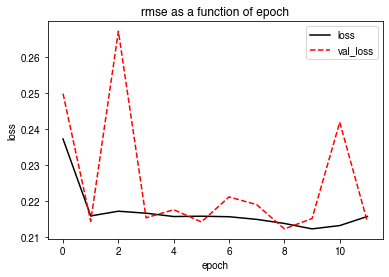

492/492 [==============================] - 3754s 8s/step - loss: 0.2157 - root_mean_squared_error: 0.2158 - val_loss: 0.2142 - val_root_mean_squared_error: 0.2143


In [103]:
RN_history = resnet50_model.fit(training_generator,validation_data=validation_generator, epochs=12,
                callbacks=[plot_losses],steps_per_epoch=492, initial_epoch=0, use_multiprocessing=True, workers=8)

In [102]:
updated_rnet50.summary()

Model: "model_19"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_43 (InputLayer)           [(None, 64, 64, 3)]  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 70, 70, 3)    0           input_43[0][0]                   
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 32, 32, 64)   9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 32, 32, 64)   256         conv1_conv[0][0]                 
___________________________________________________________________________________________

In [98]:
resnet50_model.save('trained_OOB_resnet50')

INFO:tensorflow:Assets written to: trained_OOB_resnet50/assets


In [52]:
max_lr=5e-2
min_lr=1e-6
rando = tf.convert_to_tensor([np.random.uniform(low=0,high=1,size=37)])

def schedule(lr, epoch):
    
    if (epoch+1)%2==0:
        
        return float(max_lr*np.exp(-epoch*.5))
    
lr_sched = tf.keras.callbacks.LearningRateScheduler(schedule)

optimizer = tf.keras.optimizers.Adam()

modified_rnet50 = tf.keras.applications.ResNet50(
                        include_top=True,
                        weights=None,
                        input_tensor=None,
                        input_shape=(64,64,3),
                        pooling="max",
                        classes=37,
                    )

modded_rnet50.compile(optimizer=optimizer, loss=rmse, metrics=[tf.keras.metrics.RootMeanSquaredError()])

ValueError: Dimension incompatibility 37 != 1. Layer shapes: (37, 37), (37, 1)

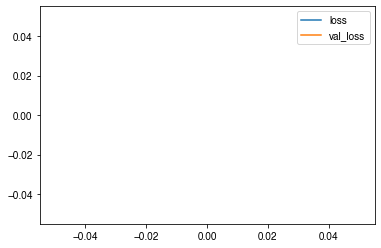

  1/707 [..............................] - ETA: 9:19

ValueError: No gradients provided for any variable: ['conv1_conv_8/kernel:0', 'conv1_conv_8/bias:0', 'conv1_bn_8/gamma:0', 'conv1_bn_8/beta:0', 'conv2_block1_1_conv_8/kernel:0', 'conv2_block1_1_conv_8/bias:0', 'conv2_block1_1_bn_8/gamma:0', 'conv2_block1_1_bn_8/beta:0', 'conv2_block1_2_conv_8/kernel:0', 'conv2_block1_2_conv_8/bias:0', 'conv2_block1_2_bn_8/gamma:0', 'conv2_block1_2_bn_8/beta:0', 'conv2_block1_0_conv_8/kernel:0', 'conv2_block1_0_conv_8/bias:0', 'conv2_block1_3_conv_8/kernel:0', 'conv2_block1_3_conv_8/bias:0', 'conv2_block1_0_bn_8/gamma:0', 'conv2_block1_0_bn_8/beta:0', 'conv2_block1_3_bn_8/gamma:0', 'conv2_block1_3_bn_8/beta:0', 'conv2_block2_1_conv_8/kernel:0', 'conv2_block2_1_conv_8/bias:0', 'conv2_block2_1_bn_8/gamma:0', 'conv2_block2_1_bn_8/beta:0', 'conv2_block2_2_conv_8/kernel:0', 'conv2_block2_2_conv_8/bias:0', 'conv2_block2_2_bn_8/gamma:0', 'conv2_block2_2_bn_8/beta:0', 'conv2_block2_3_conv_8/kernel:0', 'conv2_block2_3_conv_8/bias:0', 'conv2_block2_3_bn_8/gamma:0', 'conv2_block2_3_bn_8/beta:0', 'conv2_block3_1_conv_8/kernel:0', 'conv2_block3_1_conv_8/bias:0', 'conv2_block3_1_bn_8/gamma:0', 'conv2_block3_1_bn_8/beta:0', 'conv2_block3_2_conv_8/kernel:0', 'conv2_block3_2_conv_8/bias:0', 'conv2_block3_2_bn_8/gamma:0', 'conv2_block3_2_bn_8/beta:0', 'conv2_block3_3_conv_8/kernel:0', 'conv2_block3_3_conv_8/bias:0', 'conv2_block3_3_bn_8/gamma:0', 'conv2_block3_3_bn_8/beta:0', 'conv3_block1_1_conv_8/kernel:0', 'conv3_block1_1_conv_8/bias:0', 'conv3_block1_1_bn_8/gamma:0', 'conv3_block1_1_bn_8/beta:0', 'conv3_block1_2_conv_8/kernel:0', 'conv3_block1_2_conv_8/bias:0', 'conv3_block1_2_bn_8/gamma:0', 'conv3_block1_2_bn_8/beta:0', 'conv3_block1_0_conv_8/kernel:0', 'conv3_block1_0_conv_8/bias:0', 'conv3_block1_3_conv_8/kernel:0', 'conv3_block1_3_conv_8/bias:0', 'conv3_block1_0_bn_8/gamma:0', 'conv3_block1_0_bn_8/beta:0', 'conv3_block1_3_bn_8/gamma:0', 'conv3_block1_3_bn_8/beta:0', 'conv3_block2_1_conv_8/kernel:0', 'conv3_block2_1_conv_8/bias:0', 'conv3_block2_1_bn_8/gamma:0', 'conv3_block2_1_bn_8/beta:0', 'conv3_block2_2_conv_8/kernel:0', 'conv3_block2_2_conv_8/bias:0', 'conv3_block2_2_bn_8/gamma:0', 'conv3_block2_2_bn_8/beta:0', 'conv3_block2_3_conv_8/kernel:0', 'conv3_block2_3_conv_8/bias:0', 'conv3_block2_3_bn_8/gamma:0', 'conv3_block2_3_bn_8/beta:0', 'conv3_block3_1_conv_8/kernel:0', 'conv3_block3_1_conv_8/bias:0', 'conv3_block3_1_bn_8/gamma:0', 'conv3_block3_1_bn_8/beta:0', 'conv3_block3_2_conv_8/kernel:0', 'conv3_block3_2_conv_8/bias:0', 'conv3_block3_2_bn_8/gamma:0', 'conv3_block3_2_bn_8/beta:0', 'conv3_block3_3_conv_8/kernel:0', 'conv3_block3_3_conv_8/bias:0', 'conv3_block3_3_bn_8/gamma:0', 'conv3_block3_3_bn_8/beta:0', 'conv3_block4_1_conv_8/kernel:0', 'conv3_block4_1_conv_8/bias:0', 'conv3_block4_1_bn_8/gamma:0', 'conv3_block4_1_bn_8/beta:0', 'conv3_block4_2_conv_8/kernel:0', 'conv3_block4_2_conv_8/bias:0', 'conv3_block4_2_bn_8/gamma:0', 'conv3_block4_2_bn_8/beta:0', 'conv3_block4_3_conv_8/kernel:0', 'conv3_block4_3_conv_8/bias:0', 'conv3_block4_3_bn_8/gamma:0', 'conv3_block4_3_bn_8/beta:0', 'conv4_block1_1_conv_8/kernel:0', 'conv4_block1_1_conv_8/bias:0', 'conv4_block1_1_bn_8/gamma:0', 'conv4_block1_1_bn_8/beta:0', 'conv4_block1_2_conv_8/kernel:0', 'conv4_block1_2_conv_8/bias:0', 'conv4_block1_2_bn_8/gamma:0', 'conv4_block1_2_bn_8/beta:0', 'conv4_block1_0_conv_8/kernel:0', 'conv4_block1_0_conv_8/bias:0', 'conv4_block1_3_conv_8/kernel:0', 'conv4_block1_3_conv_8/bias:0', 'conv4_block1_0_bn_8/gamma:0', 'conv4_block1_0_bn_8/beta:0', 'conv4_block1_3_bn_8/gamma:0', 'conv4_block1_3_bn_8/beta:0', 'conv4_block2_1_conv_8/kernel:0', 'conv4_block2_1_conv_8/bias:0', 'conv4_block2_1_bn_8/gamma:0', 'conv4_block2_1_bn_8/beta:0', 'conv4_block2_2_conv_8/kernel:0', 'conv4_block2_2_conv_8/bias:0', 'conv4_block2_2_bn_8/gamma:0', 'conv4_block2_2_bn_8/beta:0', 'conv4_block2_3_conv_8/kernel:0', 'conv4_block2_3_conv_8/bias:0', 'conv4_block2_3_bn_8/gamma:0', 'conv4_block2_3_bn_8/beta:0', 'conv4_block3_1_conv_8/kernel:0', 'conv4_block3_1_conv_8/bias:0', 'conv4_block3_1_bn_8/gamma:0', 'conv4_block3_1_bn_8/beta:0', 'conv4_block3_2_conv_8/kernel:0', 'conv4_block3_2_conv_8/bias:0', 'conv4_block3_2_bn_8/gamma:0', 'conv4_block3_2_bn_8/beta:0', 'conv4_block3_3_conv_8/kernel:0', 'conv4_block3_3_conv_8/bias:0', 'conv4_block3_3_bn_8/gamma:0', 'conv4_block3_3_bn_8/beta:0', 'conv4_block4_1_conv_8/kernel:0', 'conv4_block4_1_conv_8/bias:0', 'conv4_block4_1_bn_8/gamma:0', 'conv4_block4_1_bn_8/beta:0', 'conv4_block4_2_conv_8/kernel:0', 'conv4_block4_2_conv_8/bias:0', 'conv4_block4_2_bn_8/gamma:0', 'conv4_block4_2_bn_8/beta:0', 'conv4_block4_3_conv_8/kernel:0', 'conv4_block4_3_conv_8/bias:0', 'conv4_block4_3_bn_8/gamma:0', 'conv4_block4_3_bn_8/beta:0', 'conv4_block5_1_conv_8/kernel:0', 'conv4_block5_1_conv_8/bias:0', 'conv4_block5_1_bn_8/gamma:0', 'conv4_block5_1_bn_8/beta:0', 'conv4_block5_2_conv_8/kernel:0', 'conv4_block5_2_conv_8/bias:0', 'conv4_block5_2_bn_8/gamma:0', 'conv4_block5_2_bn_8/beta:0', 'conv4_block5_3_conv_8/kernel:0', 'conv4_block5_3_conv_8/bias:0', 'conv4_block5_3_bn_8/gamma:0', 'conv4_block5_3_bn_8/beta:0', 'conv4_block6_1_conv_8/kernel:0', 'conv4_block6_1_conv_8/bias:0', 'conv4_block6_1_bn_8/gamma:0', 'conv4_block6_1_bn_8/beta:0', 'conv4_block6_2_conv_8/kernel:0', 'conv4_block6_2_conv_8/bias:0', 'conv4_block6_2_bn_8/gamma:0', 'conv4_block6_2_bn_8/beta:0', 'conv4_block6_3_conv_8/kernel:0', 'conv4_block6_3_conv_8/bias:0', 'conv4_block6_3_bn_8/gamma:0', 'conv4_block6_3_bn_8/beta:0', 'conv5_block1_1_conv_8/kernel:0', 'conv5_block1_1_conv_8/bias:0', 'conv5_block1_1_bn_8/gamma:0', 'conv5_block1_1_bn_8/beta:0', 'conv5_block1_2_conv_8/kernel:0', 'conv5_block1_2_conv_8/bias:0', 'conv5_block1_2_bn_8/gamma:0', 'conv5_block1_2_bn_8/beta:0', 'conv5_block1_0_conv_8/kernel:0', 'conv5_block1_0_conv_8/bias:0', 'conv5_block1_3_conv_8/kernel:0', 'conv5_block1_3_conv_8/bias:0', 'conv5_block1_0_bn_8/gamma:0', 'conv5_block1_0_bn_8/beta:0', 'conv5_block1_3_bn_8/gamma:0', 'conv5_block1_3_bn_8/beta:0', 'conv5_block2_1_conv_8/kernel:0', 'conv5_block2_1_conv_8/bias:0', 'conv5_block2_1_bn_8/gamma:0', 'conv5_block2_1_bn_8/beta:0', 'conv5_block2_2_conv_8/kernel:0', 'conv5_block2_2_conv_8/bias:0', 'conv5_block2_2_bn_8/gamma:0', 'conv5_block2_2_bn_8/beta:0', 'conv5_block2_3_conv_8/kernel:0', 'conv5_block2_3_conv_8/bias:0', 'conv5_block2_3_bn_8/gamma:0', 'conv5_block2_3_bn_8/beta:0', 'conv5_block3_1_conv_8/kernel:0', 'conv5_block3_1_conv_8/bias:0', 'conv5_block3_1_bn_8/gamma:0', 'conv5_block3_1_bn_8/beta:0', 'conv5_block3_2_conv_8/kernel:0', 'conv5_block3_2_conv_8/bias:0', 'conv5_block3_2_bn_8/gamma:0', 'conv5_block3_2_bn_8/beta:0', 'conv5_block3_3_conv_8/kernel:0', 'conv5_block3_3_conv_8/bias:0', 'conv5_block3_3_bn_8/gamma:0', 'conv5_block3_3_bn_8/beta:0', 'probs_8/kernel:0', 'probs_8/bias:0'].

In [77]:
training_generator = DataGenerator(partition['train'], labels, dim=(64,64), n_channels=3, batch_size=70,
                                   shuffle=True, folder_name='training_images/', augment=True,
                                  unaugmented_dim=(424,424))
validation_generator = DataGenerator(partition['validation'], labels, dim=(64,64),batch_size=70,
                                         n_channels=3, folder_name='reduced_training_images/')

RN_history = modded_rnet50.fit(training_generator,validation_data=validation_generator, epochs=12,
                callbacks=[plot_losses, lr_sched],steps_per_epoch=707, initial_epoch=0, use_multiprocessing=True,
                                 workers=8)

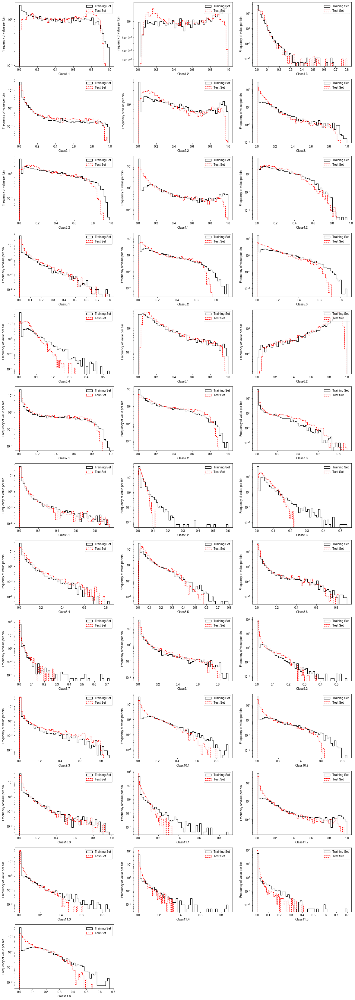

In [56]:
i=0
j=0

fig, axes = plt.subplots(nrows=13, ncols=3, figsize=(20,60))

for real_labels, pred_labels, hdr in zip(validation_labelsT, np.matrix.transpose(val_labels), hdrs[1:]):
    
    n, bins, _ = axes[i,j].hist(real_labels, bins=50, histtype='step', color='k',
                                lw=1.2,density=True,label='Training Set')
    n_test, bins_test, _ = axes[i,j].hist(pred_labels, bins=50, histtype='step',color='r',
                                         lw=1.2,ls='dashed',density=True, label='Test Set')
    
    
    axes[i,j].set_yscale('log')

    axes[i,j].set_xlabel(f'{hdr}')
    axes[i,j].set_ylabel('Frequency of value per bin')
    axes[i,j].legend()
    j+=1
    
    if j==3:
        i+=1
        j=0

fig.delaxes(axes[12][1])
fig.delaxes(axes[12][2])
fig.savefig('predicted_labels.jpg',dpi=250)
plt.show()

In [69]:
updated_pred_labels = []

for val in pred_labels:
    
    updated_pred_labels.append(np.matmul(cor_mat, val))

[[ 1.         -0.99241594  0.28086332 ... -0.2347348  -0.16620722
  -0.40410064]
 [-0.99241594  1.         -0.39671043 ...  0.2346634   0.16643237
   0.40782168]
 [ 0.28086332 -0.39671043  1.         ... -0.07927038 -0.058281
  -0.16647745]
 ...
 [-0.2347348   0.2346634  -0.07927038 ...  1.          0.34315198
   0.1812479 ]
 [-0.16620722  0.16643237 -0.058281   ...  0.34315198  1.
   0.17358421]
 [-0.40410064  0.40782168 -0.16647745 ...  0.1812479   0.17358421
   1.        ]]


In [74]:
print(np.matmul(cor_mat, val_labels[0]))

[-0.41587478  0.4315715  -0.26398244 -0.73066234  0.93816054  0.32647905
  0.90972097  0.61483088  0.59868499  0.22771774  0.72089191  0.60529937
  0.25529356  0.12915943 -0.12915943 -0.39011703  0.14232253 -0.50216377
  0.19986637 -0.03167778  0.1579877   0.22310117 -0.06741136 -0.04976449
 -0.19801441 -0.61202728 -0.46235373 -0.54389098  0.55569184  0.50275849
  0.24669491  0.21050097  0.38167336  0.28868898  0.22643469  0.18450795
  0.51767415]


In [75]:
val_labels[0]

array([0.55114114, 0.41814664, 0.03710559, 0.02575365, 0.41261947,
       0.06682092, 0.3878702 , 0.08463329, 0.36671948, 0.04789606,
       0.2211707 , 0.17620718, 0.04793167, 0.2928366 , 0.694885  ,
       0.09456512, 0.5309315 , 0.02030122, 0.02184317, 0.01892942,
       0.0558193 , 0.07207203, 0.13096353, 0.04852885, 0.00276014,
       0.02335057, 0.00417307, 0.00540379, 0.04414961, 0.03780785,
       0.01803634, 0.01086184, 0.02633202, 0.00311527, 0.00170875,
       0.00308371, 0.05127016], dtype=float32)